In [1]:
import numpy
import numpy as np
import time
import datetime
import netCDF4
import matplotlib.pylab as plt
import os,sys,glob
from multiprocessing import Pool
#import odb
from eccodes import *
from functools import partial
from collections import OrderedDict
import subprocess
import json
import gzip
import copy
import pickle
import xarray as xr
import pickle
import pandas as pd
import matplotlib
import matplotlib.pylab as plt
import matplotlib.pyplot as maplt
matplotlib.rcParams.update({'font.size': 20})

plt.rcParams['lines.linewidth'] = 3

import warnings
warnings.filterwarnings('ignore')

sys.path.append(os.getcwd()+'/../cds-backend/code/')
import cds_eua4 as eua
import trajectory as trj

import h5py
import ray
import pyproj
# ray.init(num_cpus=7)


no config found


In [2]:
from pyproj import Geod
g = Geod(ellps="WGS84")

In [13]:
g.fwd(lons=[16.0, 16.0], lats=[48.0, 48.0], az=[90.,0.], dist=[100000, 100000])

([17.33989224912447, 16.0],
 [47.99218505273184, 48.89928818072812],
 [-89.00430677118823, 180.0])

In [3]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.pylab as pylab
import geopandas as gpd

import matplotlib.pylab as plt
import matplotlib.colors as mcolors
import numpy

def rgb(r,g,b):
    return tuple(numpy.asarray([r,g,b],dtype=numpy.float))

def make_colormap(seq):
    """Return a LinearSegmentedColormap
    seq: a sequence of floats and RGB-tuples. The floats should be increasing
    and in the interval (0,1).
    """
    se = [(None,) * 3, 0.0]
    for s in seq:
        se.append(s[0])
        se.append(s[1])#+ list(seq) +
        seq=se+[ (None,) * 3]
        cdict = {'red': [], 'green': [], 'blue': []}
        for i, item in enumerate(seq):
            if isinstance(item, float):
                r1, g1, b1 = seq[i - 1]
                r2, g2, b2 = seq[i + 1]
                cdict['red'].append([item, r1, r2])
                cdict['green'].append([item, g1, g2])
                cdict['blue'].append([item, b1, b2])
    return mcolors.LinearSegmentedColormap('CustomMap', cdict)

rgblist=["rgb(0,0,0.3)", "rgb(0,0,0.5)",
"rgb(0,0,0.7)", "rgb(0,0,0.9)", "rgb(0,0.15,1)",
"rgb(0,0.3,1)", "rgb(0,0.45,1)", "rgb(0,0.6,1)",
"rgb(0,0.75,1)", "rgb(0,0.85,1)", "rgb(0.2,0.95,1)",
"rgb(0.45,1,1)", "rgb(0.75,1,1)", "rgb(1,1,0)",
"rgb(1,0.9,0)", "rgb(1,0.8,0)", "rgb(1,0.7,0)",
"rgb(1,0.6,0)", "rgb(1,0.5,0)", "rgb(1,0.4,0)",
"rgb(1,0.3,0)", "rgb(1,0.15,0)", "rgb(0.9,0,0)",
"rgb(0.7,0,0)", "rgb(0.5,0,0)", "rgb(0.3,0,0)"]
rgblist2=zip([eval(rgblist[l]) for l in range(len(rgblist))],numpy.linspace(0,1,len(rgblist)))

cmnew=make_colormap(rgblist2)

In [30]:
a = 'asdf'
not isinstance(a, list)

True

In [42]:
'''
STAION ME PLOTS

'''

# @ray.remote
def plot_year_me(path, year):
    if not isinstance(path, list):
        path = [path]
    diffs = {}
    difflist = []
    # dtlist = []
    
    import matplotlib
    import matplotlib.pylab as plt
    import matplotlib.pyplot as maplt
    matplotlib.rcParams.update({'font.size': 20})
    plt.rcParams['lines.linewidth'] = 3
    
    stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
#     stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,70000,85000,92500]
    diff = True
    show_date = False
    for fi  in list(path):
        with open(fi, 'rb') as file:
            results = pickle.load(file)
        for i in results[:]:


            rmse_sum_shbase_sonde, rmse_sum_shbase_adjsonde, rmse_sum_shdisp_sonde, rmse_sum_shdisp_adjsonde, \
                rms_sum_shbase, rms_sum_adjsonde, rms_sum_sonde, rms_sum_shdisp, rms_sum_dispminusbase, stat_marker \
                = copy.deepcopy(i)

            if (len(stat_marker[50000]) == 0):
                continue

            for k in [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]:
                rmse_sum_shbase_sonde[k]  = np.array(rmse_sum_shbase_sonde[k])
                rmse_sum_shbase_adjsonde[k]  = np.array(rmse_sum_shbase_adjsonde[k])
                rmse_sum_shdisp_sonde[k]  = np.array(rmse_sum_shdisp_sonde[k])
                rmse_sum_shdisp_adjsonde[k]  = np.array(rmse_sum_shdisp_adjsonde[k])
                rms_sum_shbase[k]  = np.array(rms_sum_shbase[k])
                rms_sum_adjsonde[k]  = np.array(rms_sum_adjsonde[k])
                rms_sum_sonde[k]  = np.array(rms_sum_sonde[k])
                rms_sum_shdisp[k]  = np.array(rms_sum_shdisp[k])
                rms_sum_dispminusbase[k]  = np.array(rms_sum_dispminusbase[k])


            t0 = time.time()
            rmse_shbase_sonde=[]
            # rmse_shbase_adjsonde=[]
            rmse_shdisp_sonde=[]
            # rmse_shdisp_adjsonde=[]

            # rms_shbase=[]
            # rms_adjsonde=[]
            # rms_sonde=[]
            # rms_shdisp=[]
            # rms_dispmbase=[]

            for j in range(len(stdplevs)):
                # print('calc: ', i)
        #         if stdplevs[i] == 50000:
        #             continue
                rmse_shbase_sonde.append(np.nanmean((np.array(rmse_sum_shbase_sonde[stdplevs[j]]))))
                # if show_date:    
                #     print('rmse_shbase_sonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shbase_sonde[-1])

                # rmse_shbase_adjsonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shbase_adjsonde[stdplevs[i]])**2))))
                # if show_date:    
                #     print('rmse_shbase_adjsonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shbase_adjsonde[-1])

                rmse_shdisp_sonde.append(np.nanmean((np.array(rmse_sum_shdisp_sonde[stdplevs[j]]))))
                # if show_date:    
                #     print('rmse_shdisp_sonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shdisp_sonde[-1])

                # rmse_shdisp_adjsonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shdisp_adjsonde[stdplevs[i]])**2))))
                # if show_date:    
                #     print('rmse_shdisp_adjsonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shdisp_adjsonde[-1])

                # rms_shbase.append(np.sqrt(np.nanmean((np.array(rms_sum_shbase[stdplevs[i]])**2))))
                # if show_date:    
                #     print('rms_shbase - plev: ', stdplevs[i], ' RMS: ', rms_shbase[-1])

                # rms_adjsonde.append(np.sqrt(np.nanmean((np.array(rms_sum_adjsonde[stdplevs[i]])**2))))
                # if show_date:    
                #     print('rms_adjsonde - plev: ', stdplevs[i], ' RMS: ', rms_adjsonde[-1])

                # rms_sonde.append(np.sqrt(np.nanmean((np.array(rms_sum_sonde[stdplevs[i]])**2))))
                # if show_date:    
                #     print('rms_sonde - plev: ', stdplevs[i], ' RMS: ', rms_sonde[-1])

                # rms_shdisp.append(np.sqrt(np.nanmean((np.array(rms_sum_shdisp[stdplevs[i]])**2))))
                # if show_date:
                #     print('rms_shdisp - plev: ', stdplevs[i], ' RMS: ', rms_shdisp[-1])

                # rms_dispmbase.append(np.sqrt(np.nanmean((np.array(rms_sum_dispminusbase[stdplevs[i]])**2))))
                # if show_date:
                #     print('rms_dispmbase - plev: ', stdplevs[i], ' RMS: ', rms_shdisp[-1])

            # diffs[str(stat_marker[50000][0])] = np.array(rmse_shbase_sonde)-np.array(rmse_shdisp_sonde)
            diffs[str(stat_marker[50000][0])] = np.array(rmse_shbase_sonde)
            # difflist.append(np.array(rmse_shbase_sonde)-np.array(rmse_shdisp_sonde))
            difflist.append(np.array(rmse_shbase_sonde))
            # dtlist.append(dt_marker)

    return diffs, difflist



In [36]:
# plot_year_rmse('era5_v_fc_2000_rmse_data.p', '2000')

# diffs, difflist, dtlist = plot_year_rmse('./rmse_v_out/*.p', '2000')
# diffs, difflist = plot_year_me('./rmse_fc_world_outlier_cleaned_stat_info/era5_temperature_fc_2000_rmse_data.p', '2000')
# diffs, difflist = plot_year_me('era5_humidity_fc_2000_rmse_data.p', '2000')
# diffs, difflist = plot_year_me('./rmse_fc_world_outlier_cleaned_stat_info/era5_temperature_fc_2000_rmse_data.p', '2000')




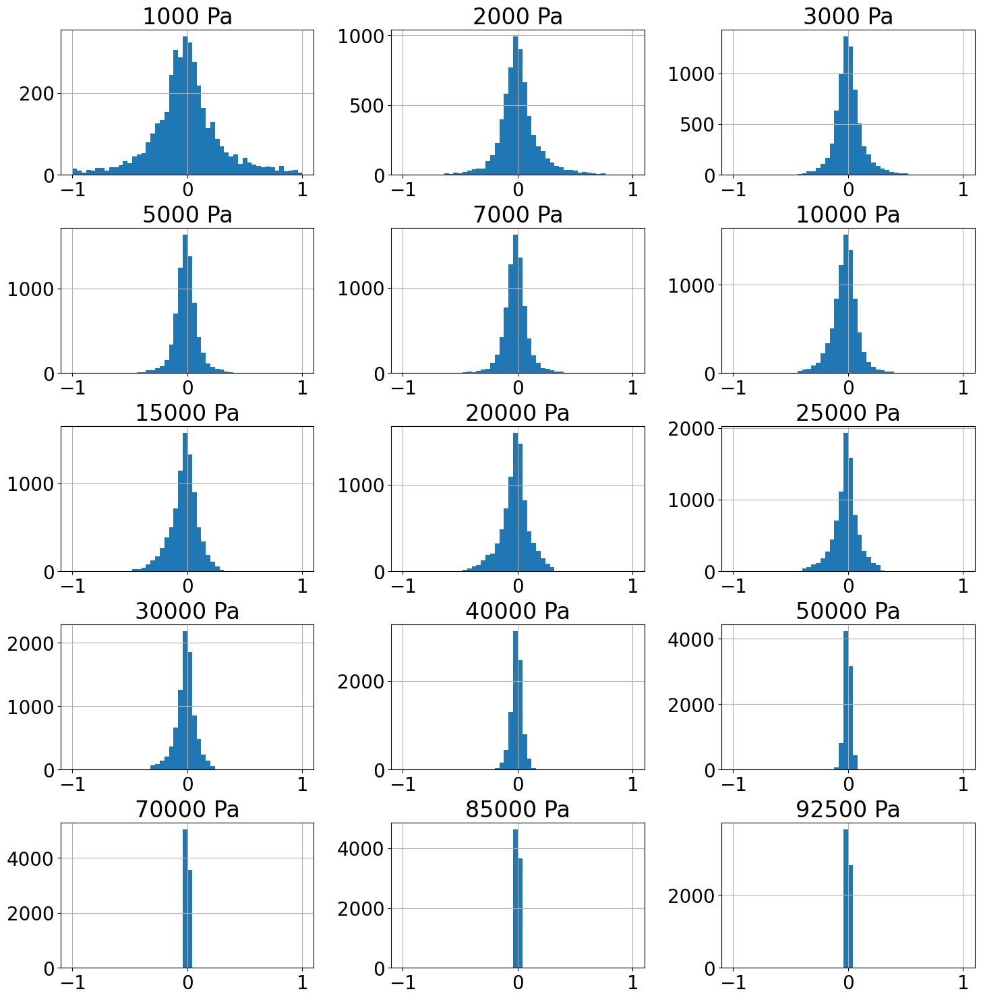

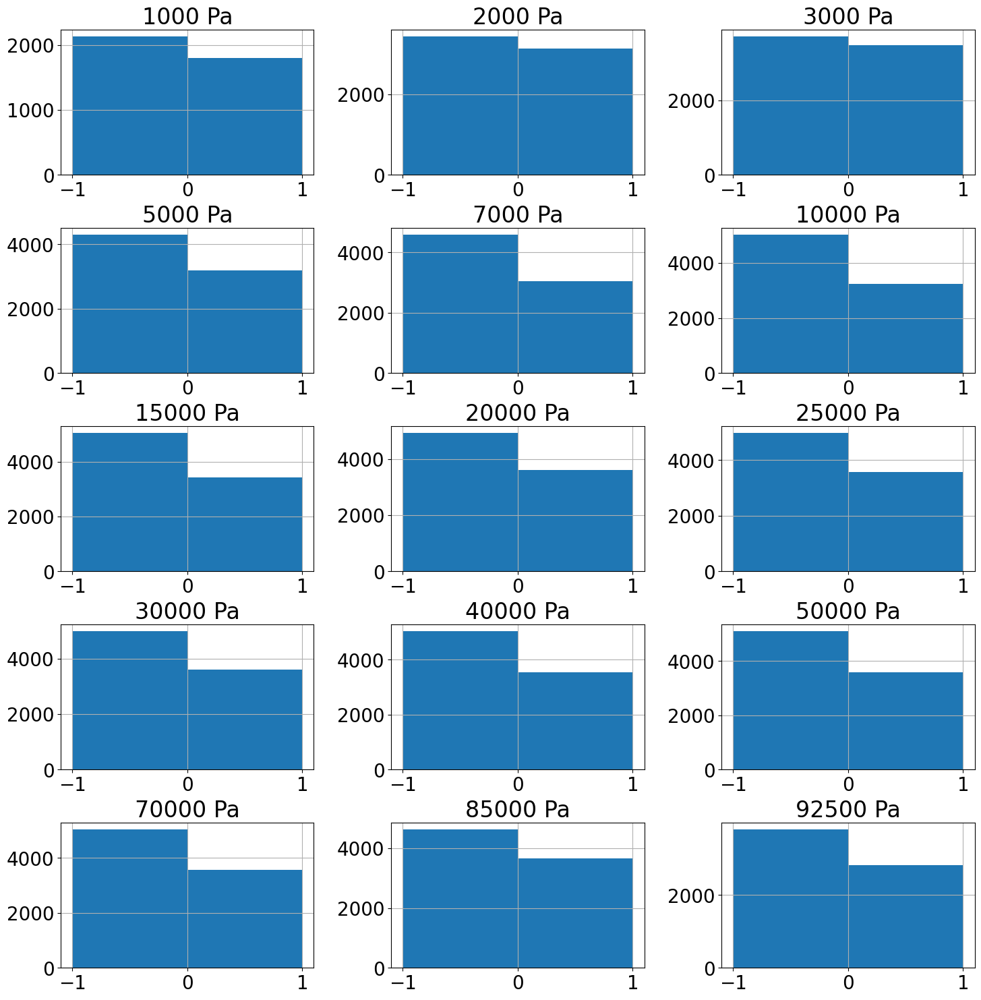

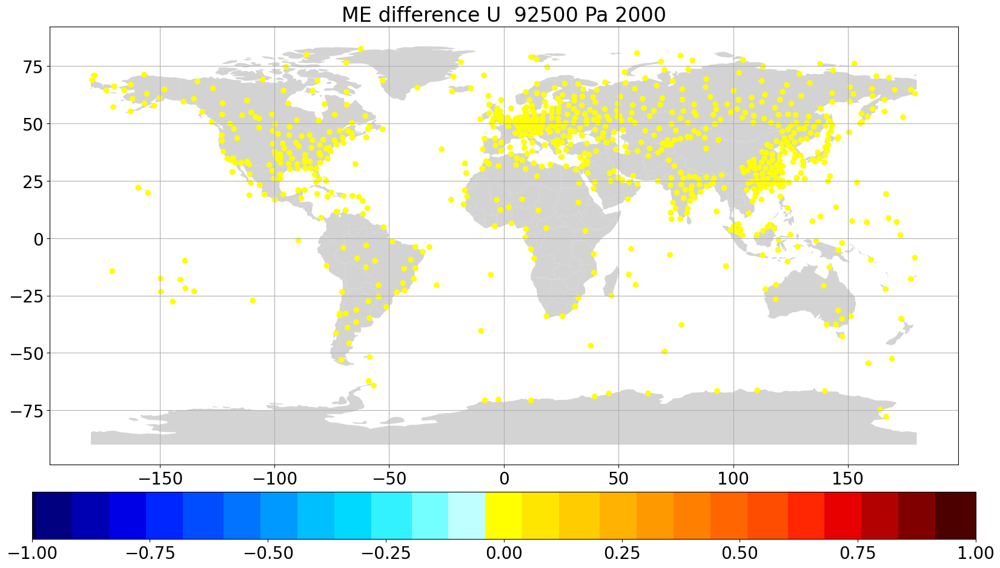

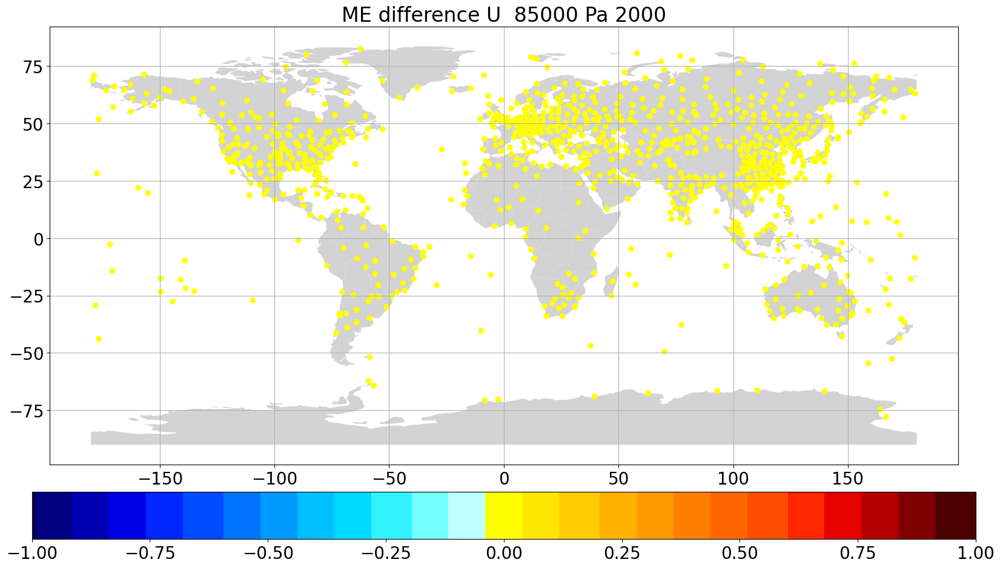

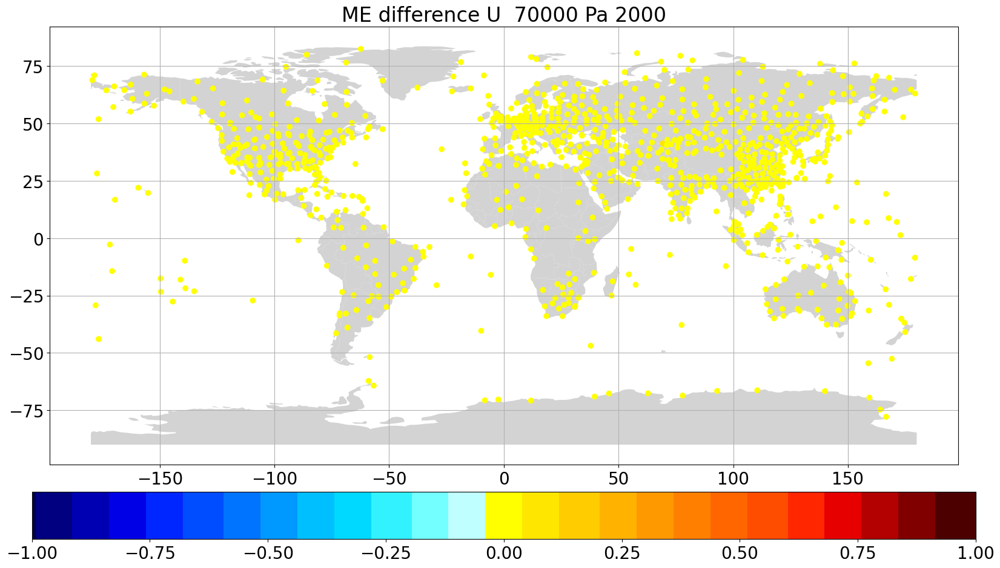

...

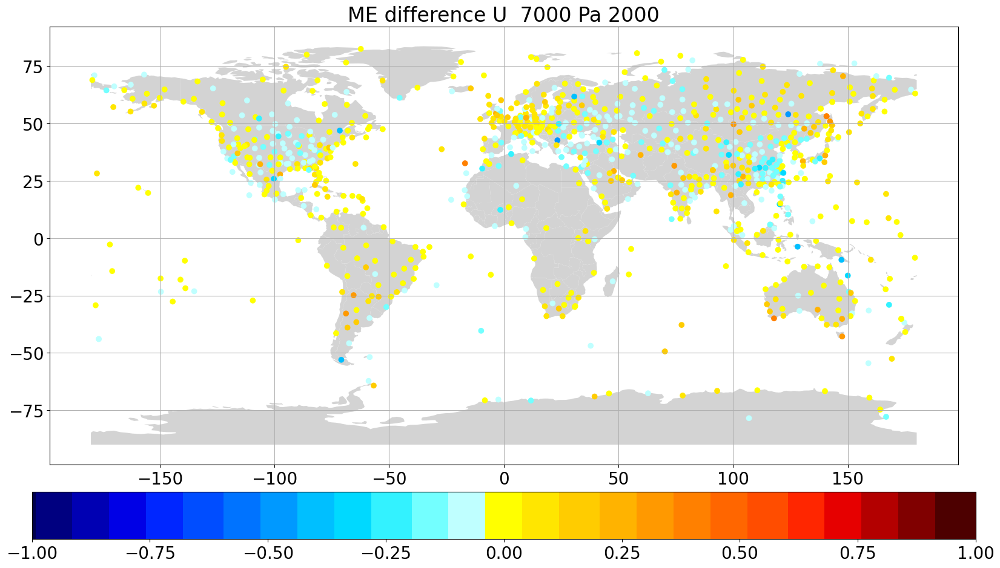

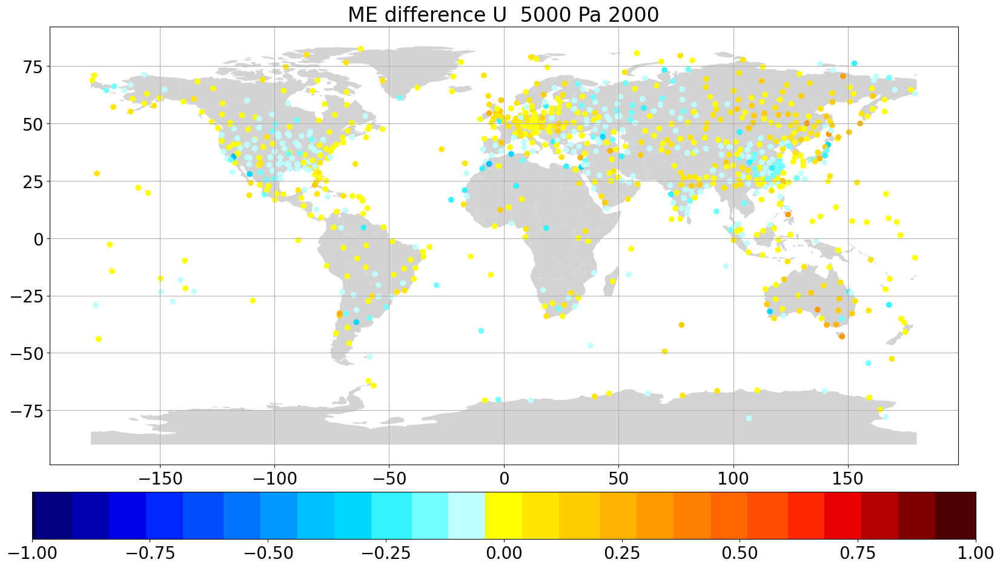

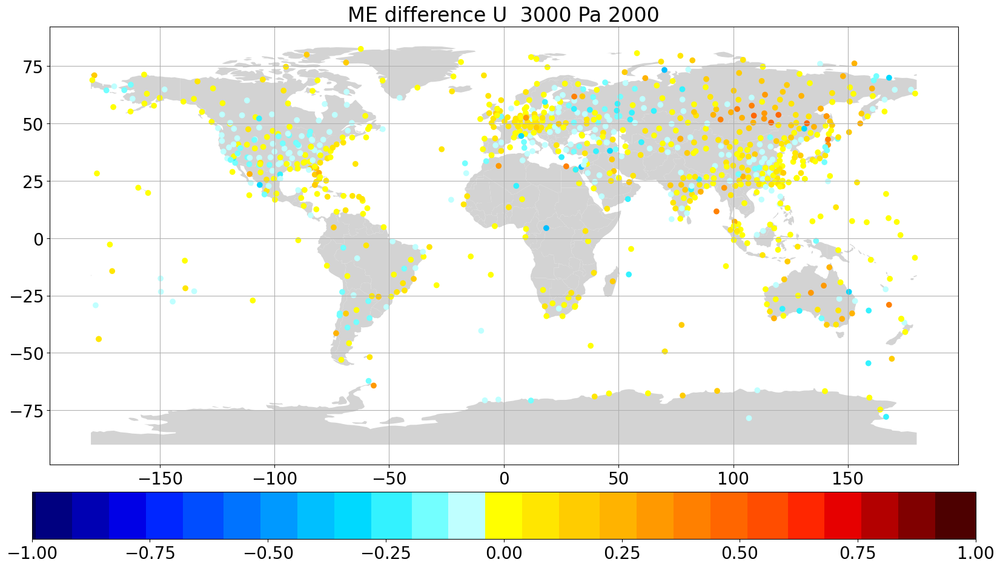

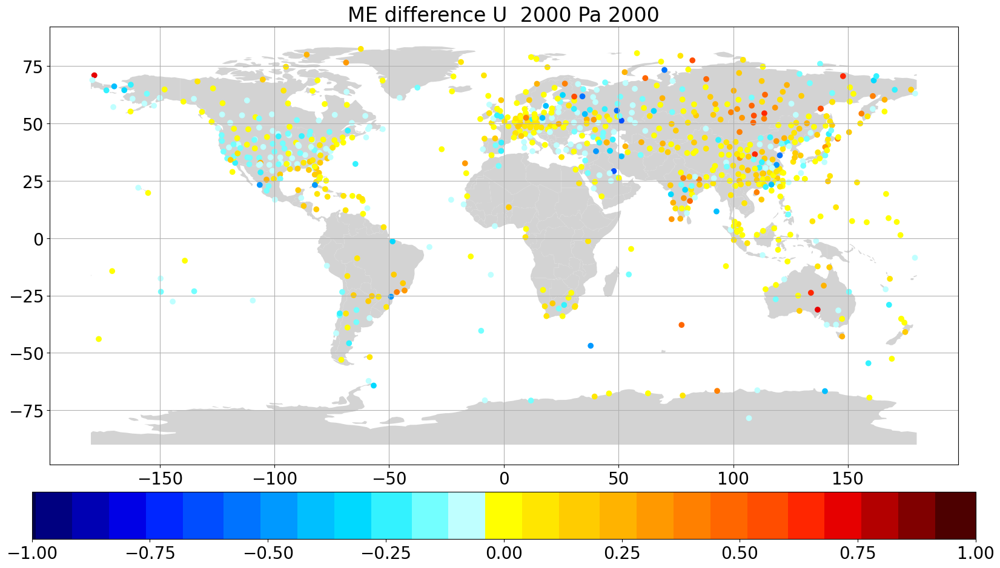

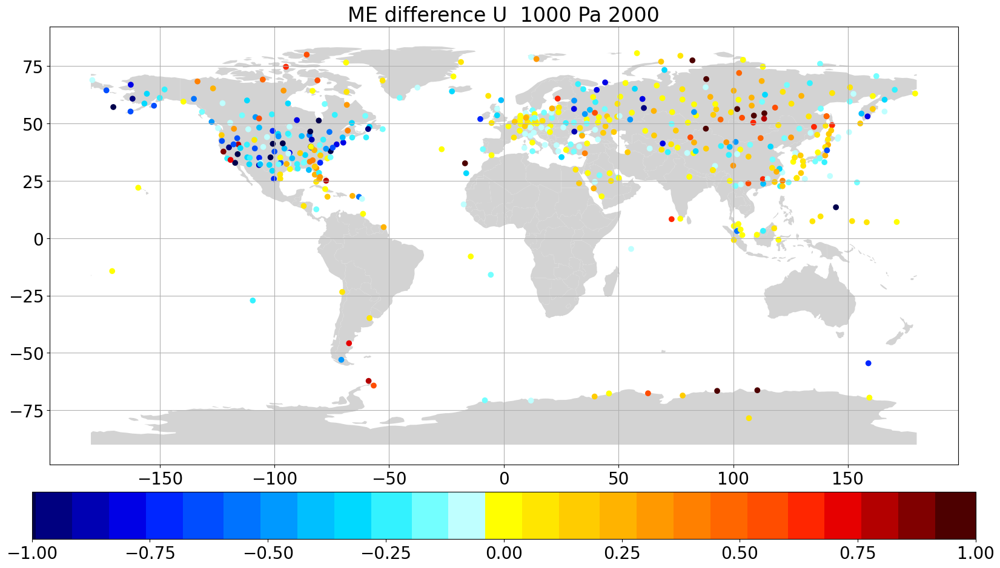

In [37]:
var = 'U'
year = 2000
files = glob.glob('./pre_calculated_rms data/era5_u_fc_*_rmse_data.p')
diffs, difflist = plot_year_me(files, '2000')


diffarray = np.array(difflist)

outlier_cleaned_data = np.empty_like(diffarray)
outlier_cleaned_dict = copy.deepcopy(diffs)
limit = [1,99]
for i in range(np.shape(diffarray)[-1]):
    data = diffarray[:, i]
    outlier_drop = np.nanpercentile(data, limit)
    data[data < outlier_drop[0]] = np.nan
    data[data > outlier_drop[1]] = np.nan
    outlier_cleaned_data[:, i] = data
    
    for j in diffs:
        if (diffs[j][i] < outlier_drop[0]) or (diffs[j][i] > outlier_drop[1]):
            outlier_cleaned_dict[j][i] = np.nan
            
    
stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
fig, ax = maplt.subplots(5, 3, figsize = (15,15))
fig.tight_layout()
x = 0
y = 0
for i in range(0,15,1):
    if y == 3:
        x += 1
        y = 0
    ax[x][y].hist(outlier_cleaned_data[:, i], 50, range=(-1,1))
    ax[x][y].set_title(str(stdplevs[i]) + ' Pa')
    ax[x][y].grid()
    
    y += 1
# fig.show()
fig.savefig("ME_difference_"+var+"_hist_" + str(year) + '.png')


stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
fig, ax = maplt.subplots(5, 3, figsize = (15,15))
fig.tight_layout()
x = 0
y = 0
for i in range(0,15,1):
    if y == 3:
        x += 1
        y = 0
    ax[x][y].hist(outlier_cleaned_data[:, i], 2, range=(-1,1))
    ax[x][y].set_title(str(stdplevs[i]) + ' Pa')
    ax[x][y].grid()
    y += 1
# fig.show()
fig.savefig("ME_difference_"+var+"_binary_hist_" + str(year) + '.png')


def plt_world_map(lla, pl ,year):    
    fig, ax = plt.subplots(figsize=(18,10))# plot map on axis
    countries = gpd.read_file(  
    #      gpd.datasets.get_path("naturalearth_lowres"))countries[countries["name"] == "Australia"].plot(color="lightgrey",
    #                                                  ax=ax)# parse dates for plot's title
        gpd.datasets.get_path("naturalearth_lowres")).plot(color="lightgrey", ax=ax)# parse dates for plot's title
    plt1 = ax.scatter(x=lla["longitude"], y=lla["latitude"],
                c=lla["diff"], 
                cmap= cmnew,
                vmin=-1, vmax=1, #edgecolor='k',
              )
    ax.set_title("ME difference "+var+" " + ' ' + str(pl) + ' Pa ' + str(year))
    ax.grid(b=True, alpha=1)
    plt.colorbar(plt1, orientation='horizontal', shrink=0.9, pad=0.05)
    plt.tight_layout()
    plt.show()
    fig.savefig("ME_difference_"+var+"_" + str(pl) + '_Pa_' + str(year) + '.png')
    plt.close()
    
with open('/users/staff/uvoggenberger/scratch/hug/config/active.json') as fp:
    active = json.load(fp)
stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
diff_plot_input = {}
for p in range(len(stdplevs)):
    diff_plot_input[stdplevs[p]] = [[],[],[]]
    for i in diffs:
        for a in active:
            if i in a:
                if not np.isnan(diffs[i][p]):
                    diff_plot_input[stdplevs[p]][0].append(outlier_cleaned_dict[i][p])
                    diff_plot_input[stdplevs[p]][1].append(active[a][2])
                    diff_plot_input[stdplevs[p]][2].append(active[a][3])
                break

stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
for i in np.flip(stdplevs):
    df = pd.DataFrame(np.transpose(np.array(diff_plot_input[i])), columns =['diff', 'latitude', 'longitude'])
    plt_world_map(df, i, '2000')

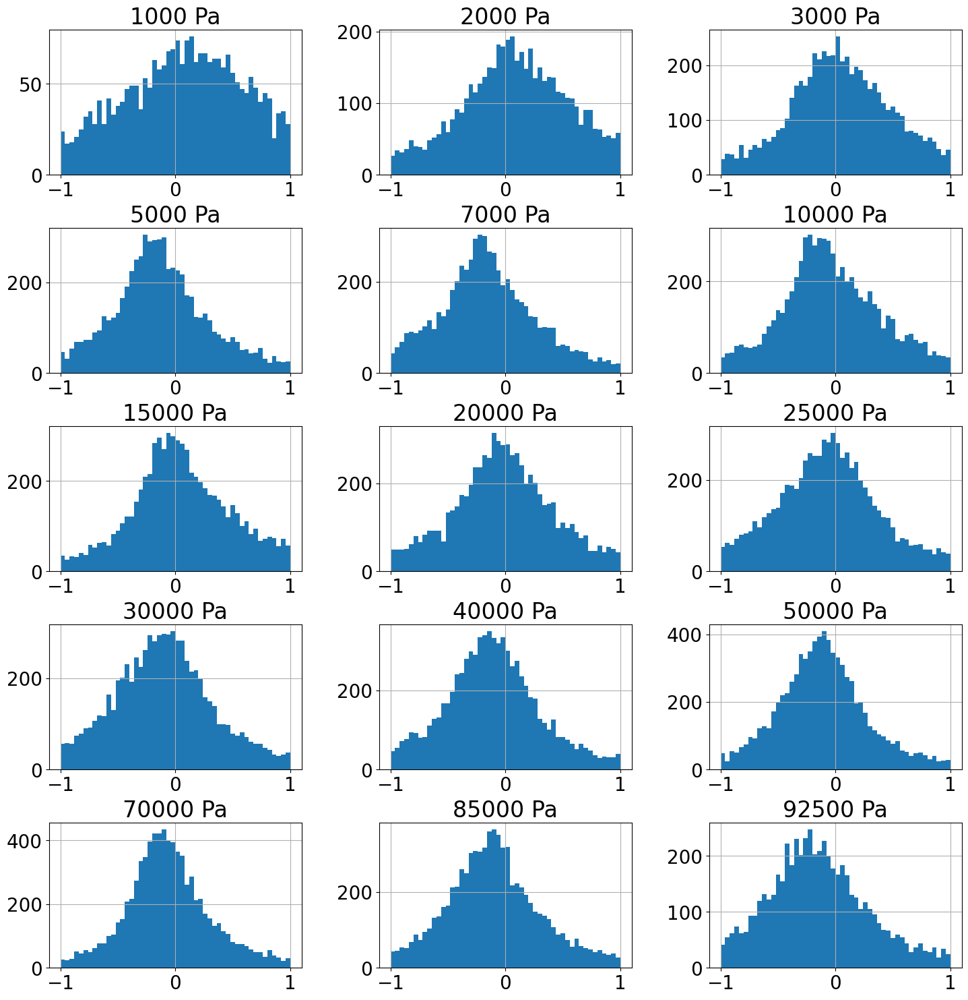

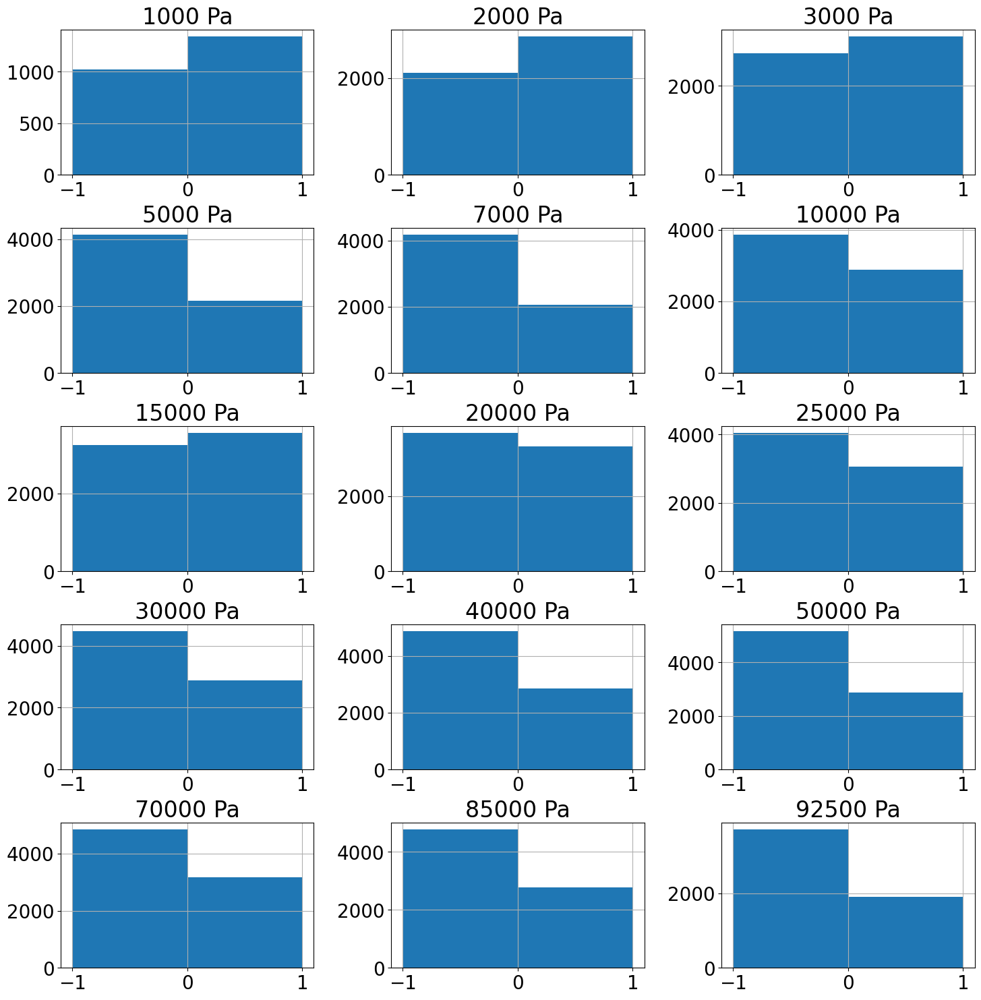

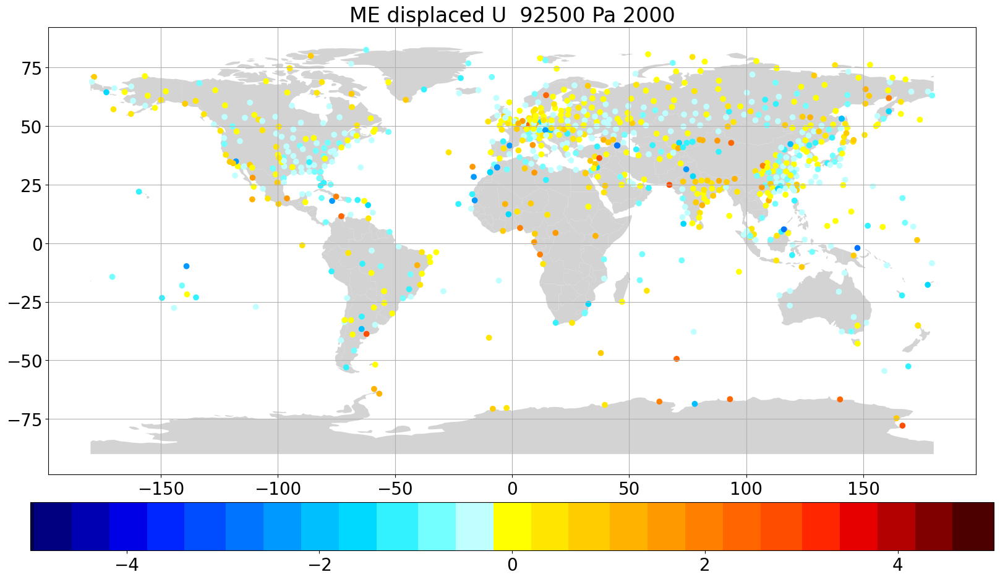

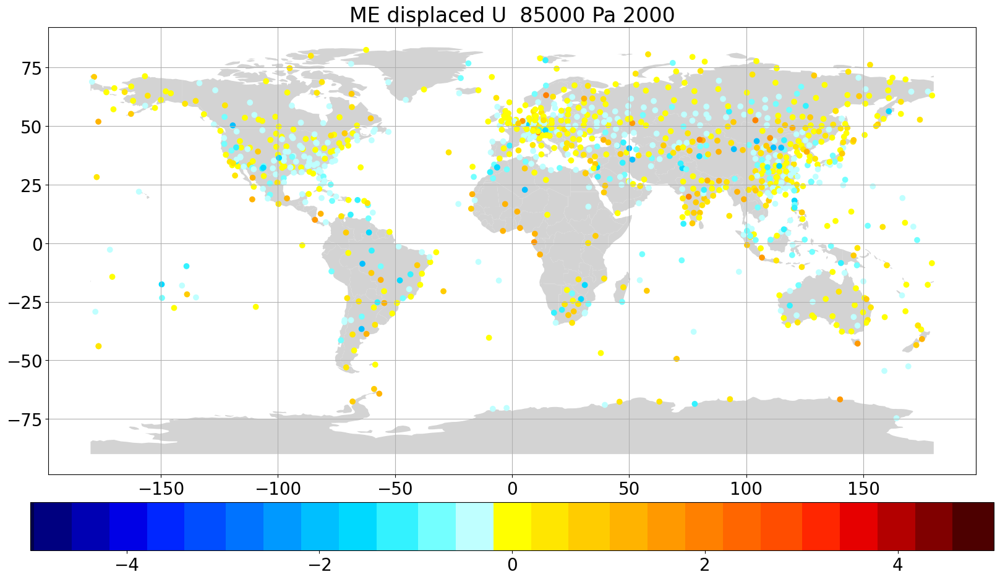

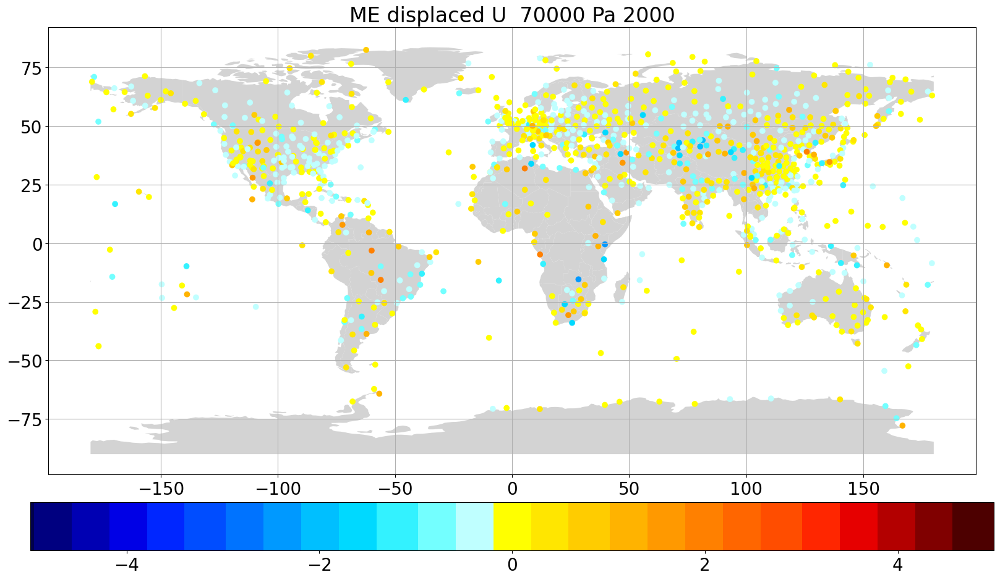

...

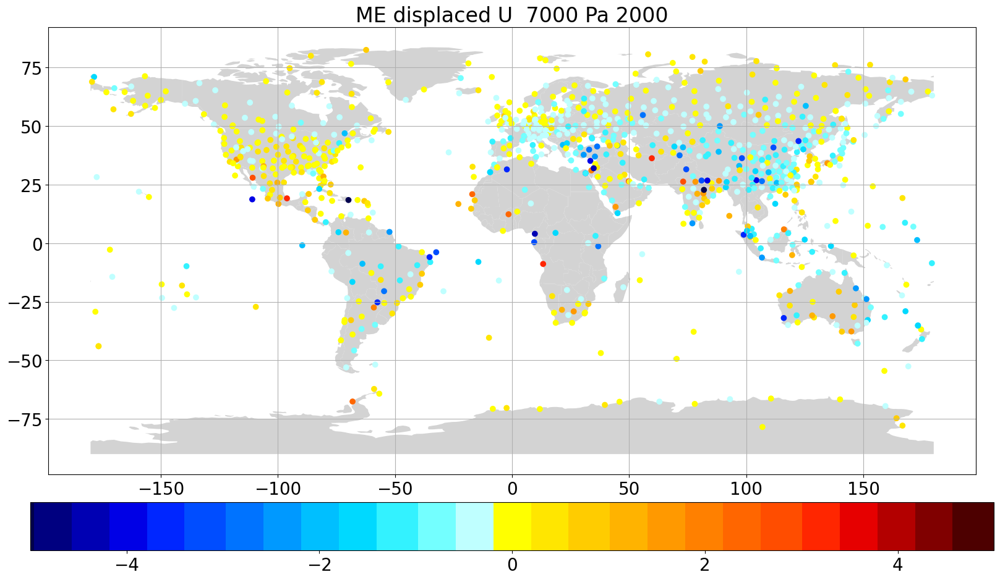

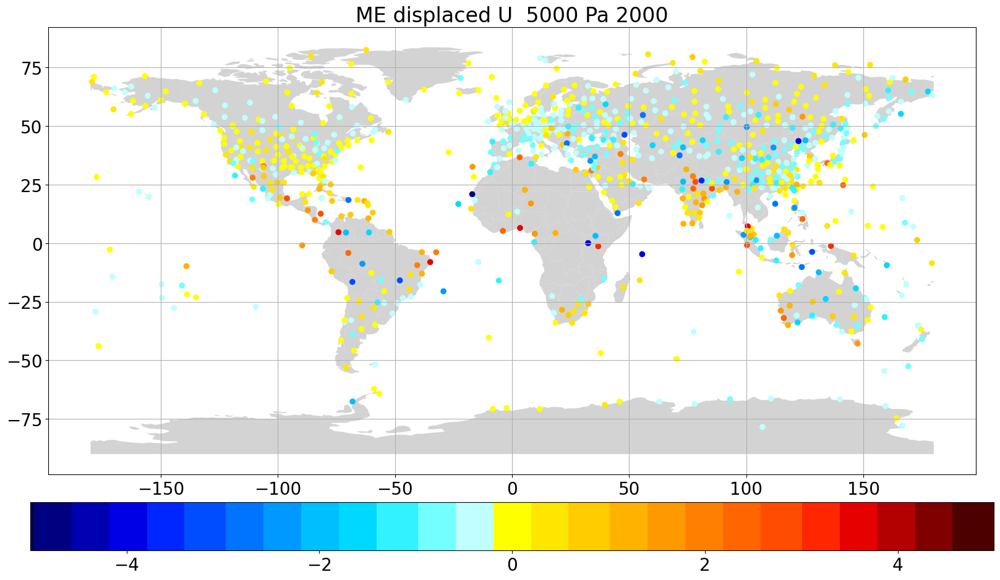

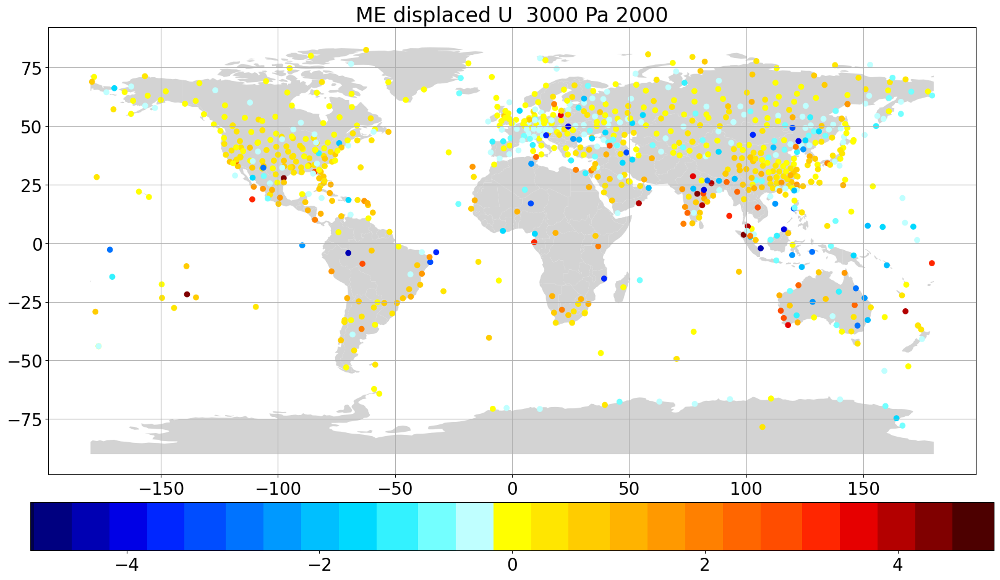

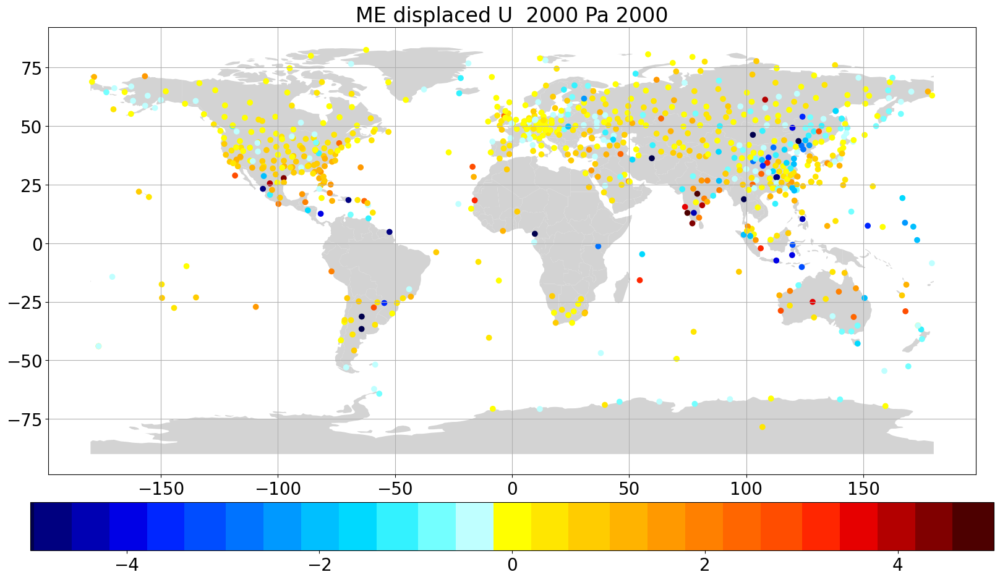

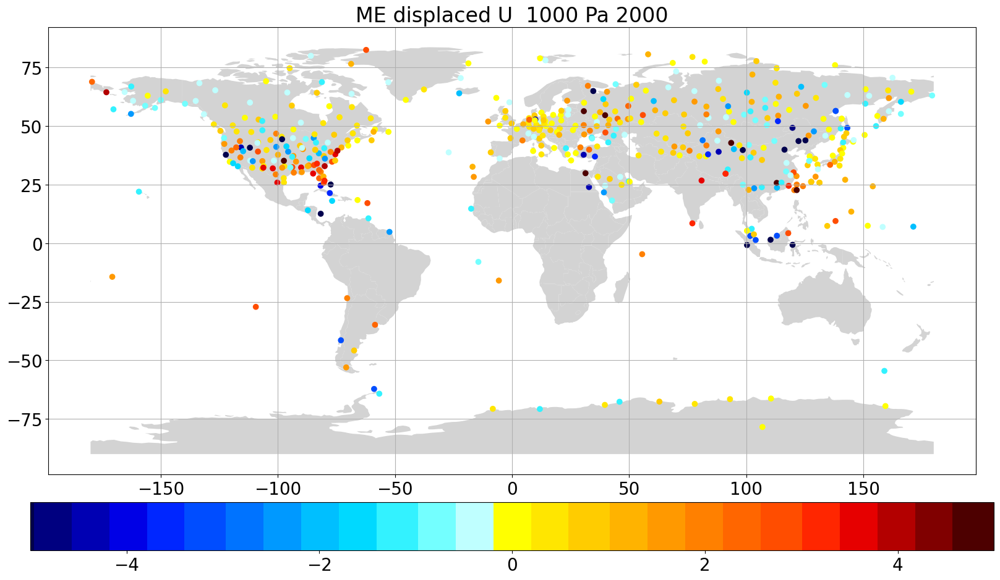

In [41]:
var = 'U'
year = 2000
files = glob.glob('./pre_calculated_rms data/era5_u_fc_*_rmse_data.p')
diffs, difflist = plot_year_me(files, '2000')


diffarray = np.array(difflist)

outlier_cleaned_data = np.empty_like(diffarray)
outlier_cleaned_dict = copy.deepcopy(diffs)
limit = [1,99]
for i in range(np.shape(diffarray)[-1]):
    data = diffarray[:, i]
    outlier_drop = np.nanpercentile(data, limit)
    data[data < outlier_drop[0]] = np.nan
    data[data > outlier_drop[1]] = np.nan
    outlier_cleaned_data[:, i] = data
    
    for j in diffs:
        if (diffs[j][i] < outlier_drop[0]) or (diffs[j][i] > outlier_drop[1]):
            outlier_cleaned_dict[j][i] = np.nan
            
    
stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
fig, ax = maplt.subplots(5, 3, figsize = (15,15))
fig.tight_layout()
x = 0
y = 0
for i in range(0,15,1):
    if y == 3:
        x += 1
        y = 0
    ax[x][y].hist(outlier_cleaned_data[:, i], 50, range=(-1,1))
    ax[x][y].set_title(str(stdplevs[i]) + ' Pa')
    ax[x][y].grid()
    
    y += 1
# fig.show()
fig.savefig("ME_difference_"+var+"_hist_" + str(year) + '.png')


stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
fig, ax = maplt.subplots(5, 3, figsize = (15,15))
fig.tight_layout()
x = 0
y = 0
for i in range(0,15,1):
    if y == 3:
        x += 1
        y = 0
    ax[x][y].hist(outlier_cleaned_data[:, i], 2, range=(-1,1))
    ax[x][y].set_title(str(stdplevs[i]) + ' Pa')
    ax[x][y].grid()
    y += 1
# fig.show()
fig.savefig("ME_difference_"+var+"_binary_hist_" + str(year) + '.png')


def plt_world_map(lla, pl ,year):    
    fig, ax = plt.subplots(figsize=(18,10))# plot map on axis
    countries = gpd.read_file(  
    #      gpd.datasets.get_path("naturalearth_lowres"))countries[countries["name"] == "Australia"].plot(color="lightgrey",
    #                                                  ax=ax)# parse dates for plot's title
        gpd.datasets.get_path("naturalearth_lowres")).plot(color="lightgrey", ax=ax)# parse dates for plot's title
    plt1 = ax.scatter(x=lla["longitude"], y=lla["latitude"],
                c=lla["diff"], 
                cmap= cmnew,
                vmin=-5, vmax=5, #edgecolor='k',
              )
    ax.set_title("ME displaced "+var+" " + ' ' + str(pl) + ' Pa ' + str(year))
    ax.grid(b=True, alpha=1)
    plt.colorbar(plt1, orientation='horizontal', shrink=0.9, pad=0.05)
    plt.tight_layout()
    plt.show()
    fig.savefig("ME_displaced_"+var+"_" + str(pl) + '_Pa_' + str(year) + '.png')
    plt.close()
    
with open('/users/staff/uvoggenberger/scratch/hug/config/active.json') as fp:
    active = json.load(fp)
stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
diff_plot_input = {}
for p in range(len(stdplevs)):
    diff_plot_input[stdplevs[p]] = [[],[],[]]
    for i in diffs:
        for a in active:
            if i in a:
                if not np.isnan(diffs[i][p]):
                    diff_plot_input[stdplevs[p]][0].append(outlier_cleaned_dict[i][p])
                    diff_plot_input[stdplevs[p]][1].append(active[a][2])
                    diff_plot_input[stdplevs[p]][2].append(active[a][3])
                break

stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
for i in np.flip(stdplevs):
    df = pd.DataFrame(np.transpose(np.array(diff_plot_input[i])), columns =['diff', 'latitude', 'longitude'])
    plt_world_map(df, i, '2000')

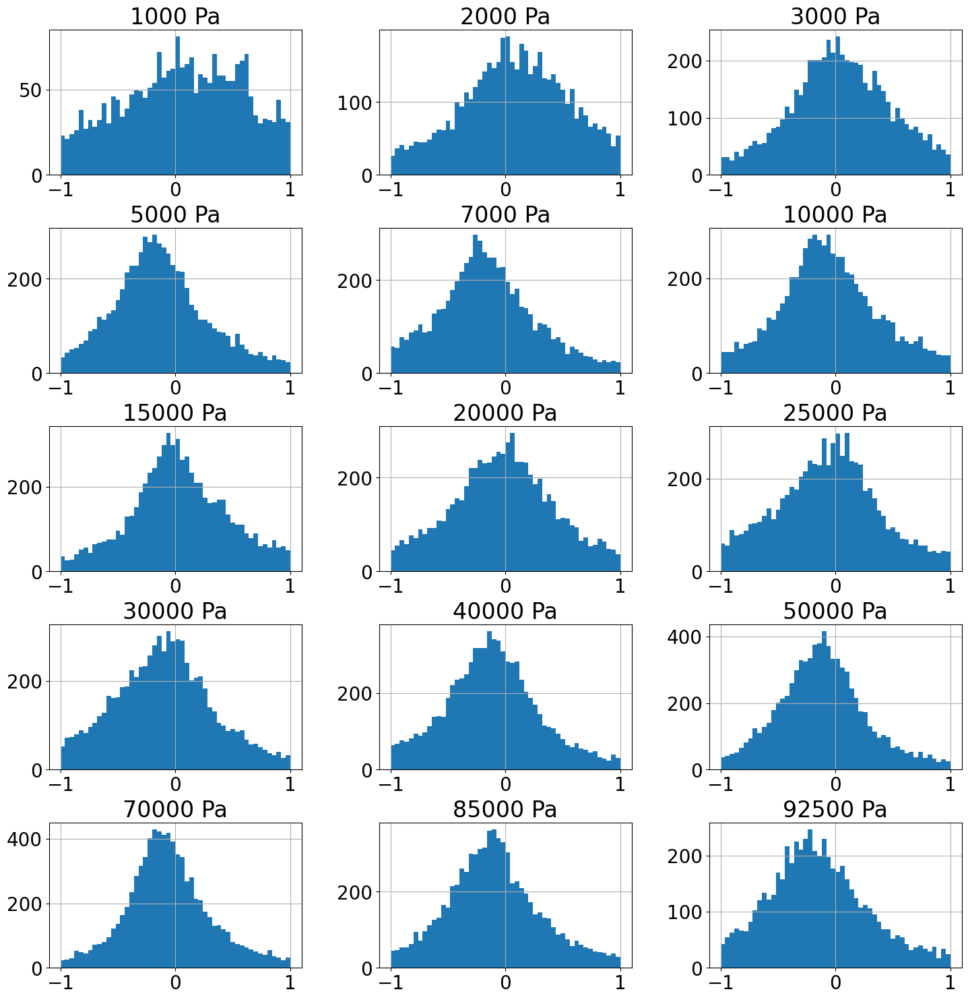

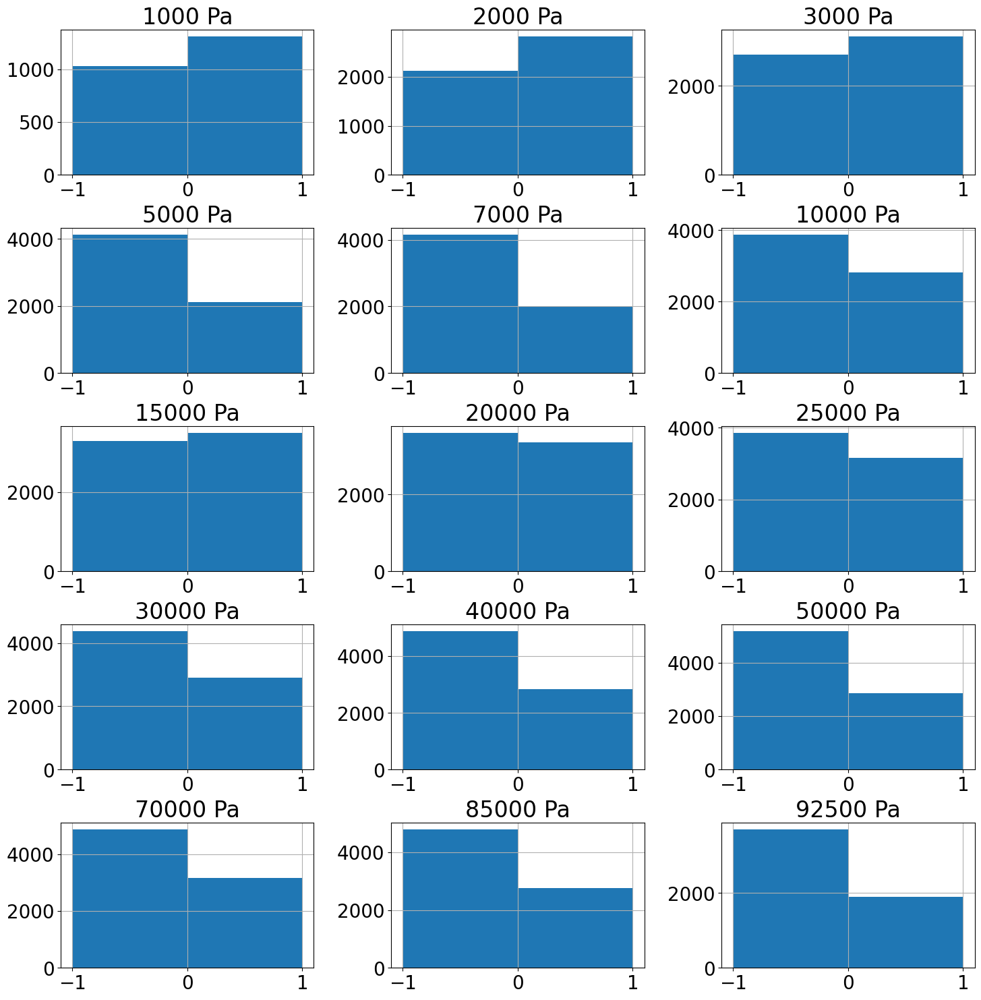

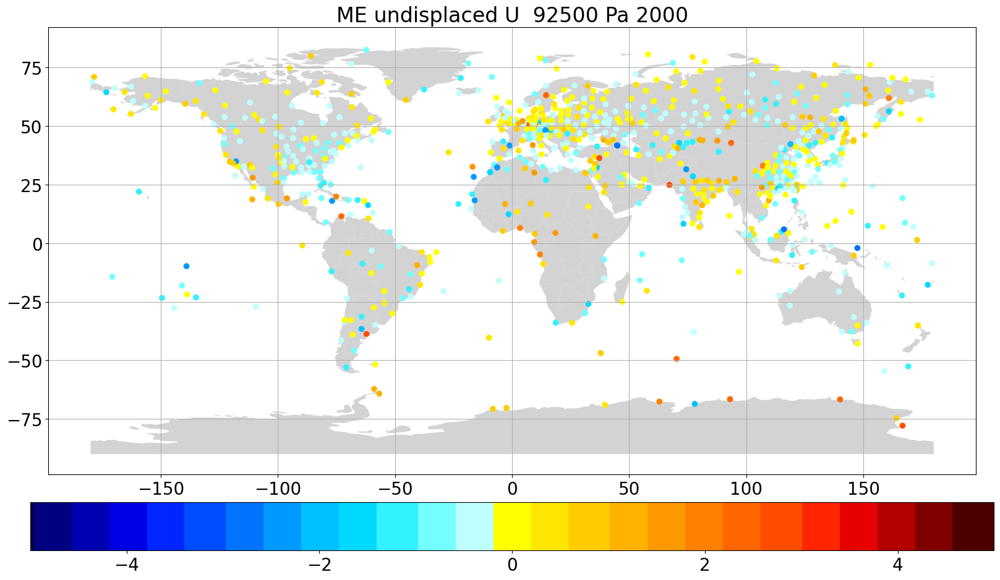

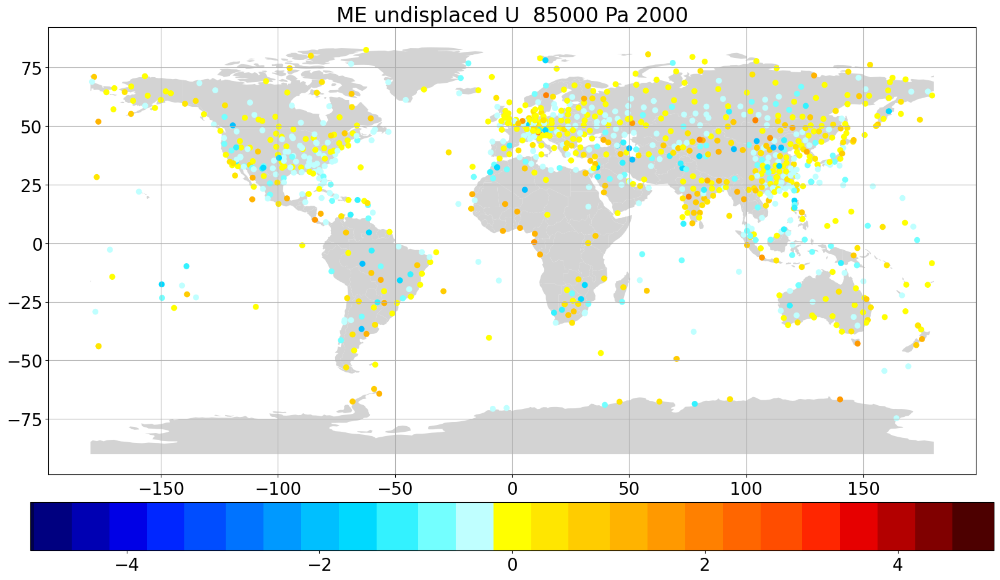

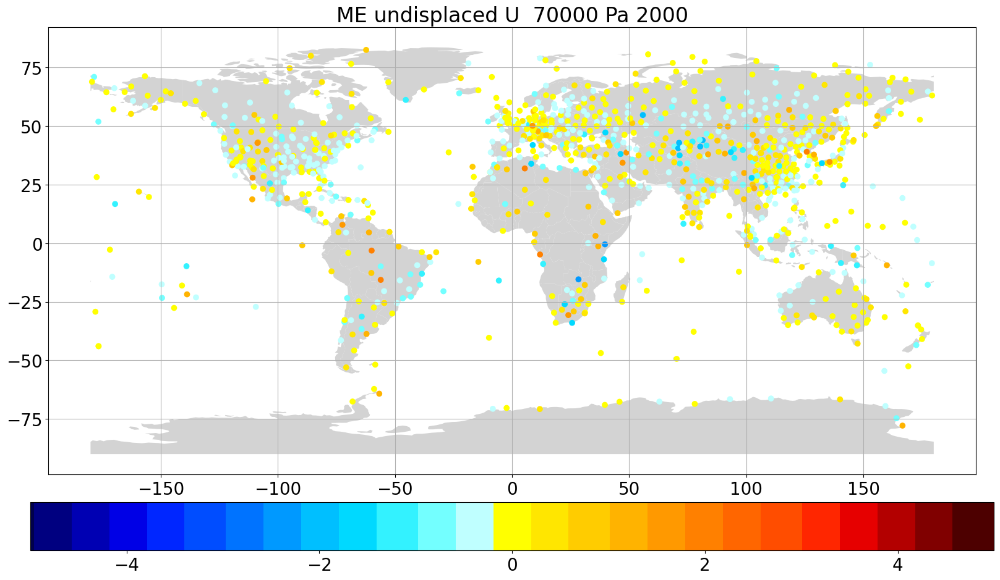

...

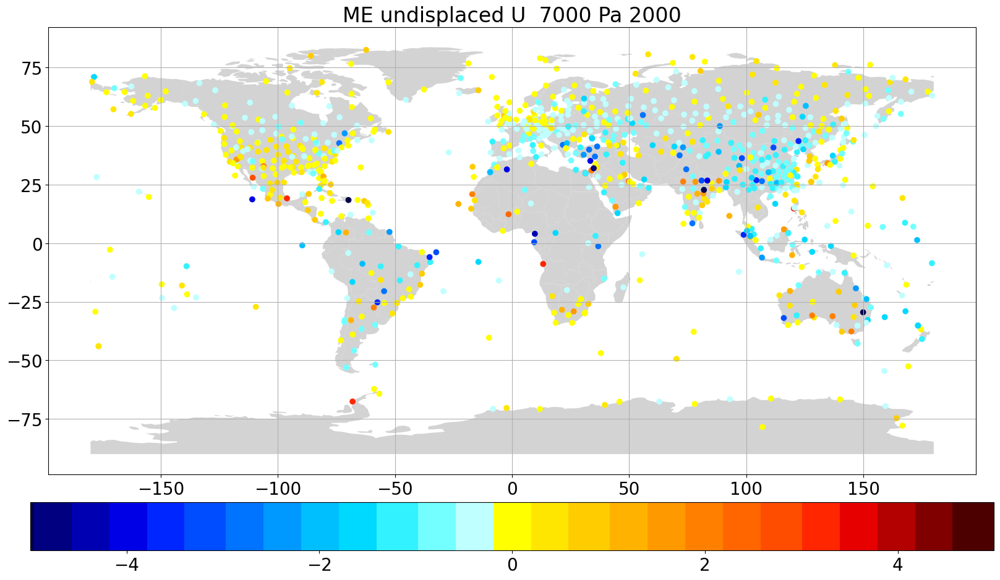

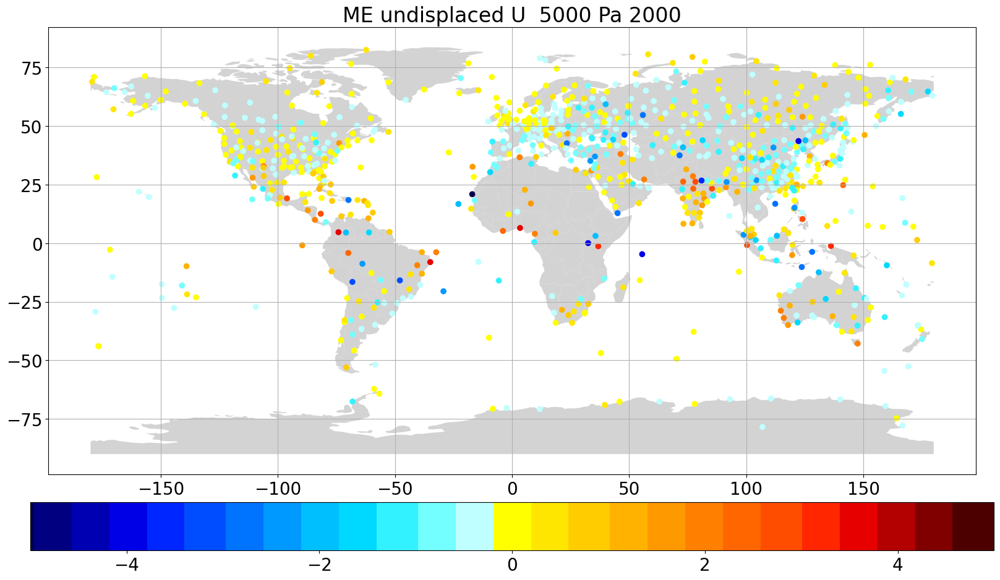

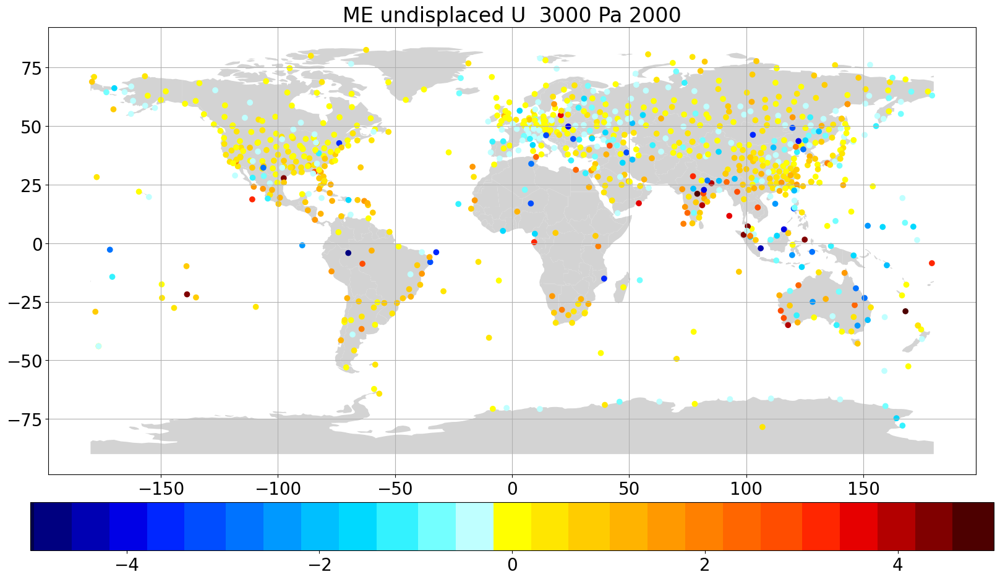

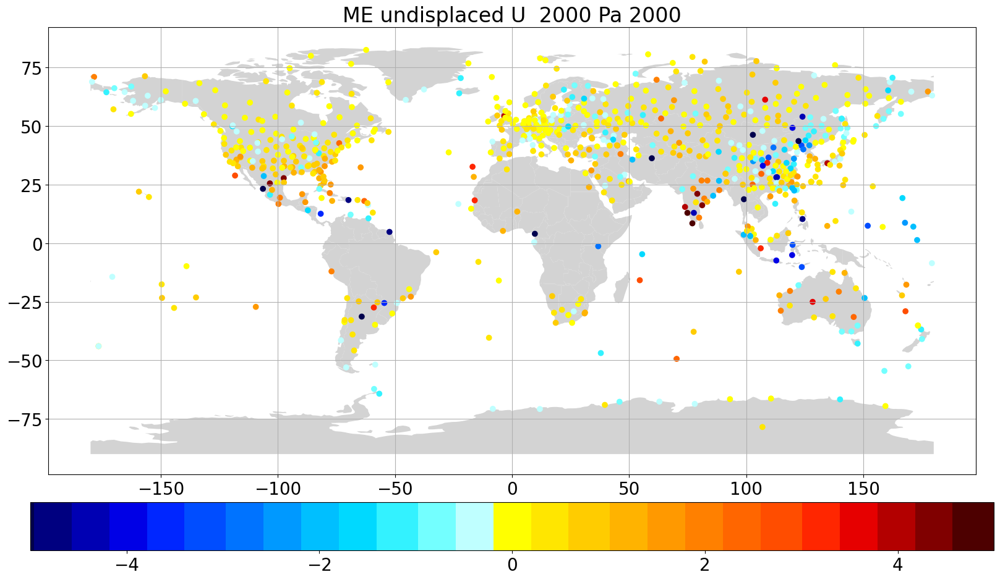

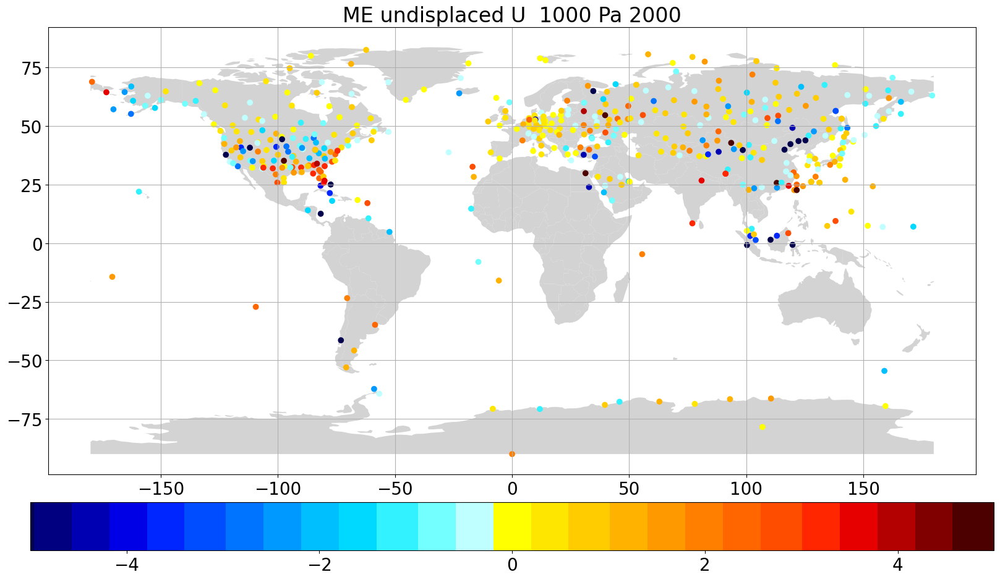

In [43]:
var = 'U'
year = 2000
files = glob.glob('./pre_calculated_rms data/era5_u_fc_*_rmse_data.p')
diffs, difflist = plot_year_me(files, '2000')


diffarray = np.array(difflist)

outlier_cleaned_data = np.empty_like(diffarray)
outlier_cleaned_dict = copy.deepcopy(diffs)
limit = [1,99]
for i in range(np.shape(diffarray)[-1]):
    data = diffarray[:, i]
    outlier_drop = np.nanpercentile(data, limit)
    data[data < outlier_drop[0]] = np.nan
    data[data > outlier_drop[1]] = np.nan
    outlier_cleaned_data[:, i] = data
    
    for j in diffs:
        if (diffs[j][i] < outlier_drop[0]) or (diffs[j][i] > outlier_drop[1]):
            outlier_cleaned_dict[j][i] = np.nan
            
    
stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
fig, ax = maplt.subplots(5, 3, figsize = (15,15))
fig.tight_layout()
x = 0
y = 0
for i in range(0,15,1):
    if y == 3:
        x += 1
        y = 0
    ax[x][y].hist(outlier_cleaned_data[:, i], 50, range=(-1,1))
    ax[x][y].set_title(str(stdplevs[i]) + ' Pa')
    ax[x][y].grid()
    
    y += 1
# fig.show()
fig.savefig("ME_difference_"+var+"_hist_" + str(year) + '.png')


stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
fig, ax = maplt.subplots(5, 3, figsize = (15,15))
fig.tight_layout()
x = 0
y = 0
for i in range(0,15,1):
    if y == 3:
        x += 1
        y = 0
    ax[x][y].hist(outlier_cleaned_data[:, i], 2, range=(-1,1))
    ax[x][y].set_title(str(stdplevs[i]) + ' Pa')
    ax[x][y].grid()
    y += 1
# fig.show()
fig.savefig("ME_difference_"+var+"_binary_hist_" + str(year) + '.png')


def plt_world_map(lla, pl ,year):    
    fig, ax = plt.subplots(figsize=(18,10))# plot map on axis
    countries = gpd.read_file(  
    #      gpd.datasets.get_path("naturalearth_lowres"))countries[countries["name"] == "Australia"].plot(color="lightgrey",
    #                                                  ax=ax)# parse dates for plot's title
        gpd.datasets.get_path("naturalearth_lowres")).plot(color="lightgrey", ax=ax)# parse dates for plot's title
    plt1 = ax.scatter(x=lla["longitude"], y=lla["latitude"],
                c=lla["diff"], 
                cmap= cmnew,
                vmin=-5, vmax=5, #edgecolor='k',
              )
    ax.set_title("ME undisplaced "+var+" " + ' ' + str(pl) + ' Pa ' + str(year))
    ax.grid(b=True, alpha=1)
    plt.colorbar(plt1, orientation='horizontal', shrink=0.9, pad=0.05)
    plt.tight_layout()
    plt.show()
    fig.savefig("ME_undisplaced_"+var+"_" + str(pl) + '_Pa_' + str(year) + '.png')
    plt.close()
    
with open('/users/staff/uvoggenberger/scratch/hug/config/active.json') as fp:
    active = json.load(fp)
stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
diff_plot_input = {}
for p in range(len(stdplevs)):
    diff_plot_input[stdplevs[p]] = [[],[],[]]
    for i in diffs:
        for a in active:
            if i in a:
                if not np.isnan(diffs[i][p]):
                    diff_plot_input[stdplevs[p]][0].append(outlier_cleaned_dict[i][p])
                    diff_plot_input[stdplevs[p]][1].append(active[a][2])
                    diff_plot_input[stdplevs[p]][2].append(active[a][3])
                break

stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
for i in np.flip(stdplevs):
    df = pd.DataFrame(np.transpose(np.array(diff_plot_input[i])), columns =['diff', 'latitude', 'longitude'])
    plt_world_map(df, i, '2000')

In [4]:
'''
STAION RMSE PLOTS

'''

# @ray.remote
def plot_year_rmse(path, year):
    
    diffs = {}
    difflist = []
    # dtlist = []
    
    import matplotlib
    import matplotlib.pylab as plt
    import matplotlib.pyplot as maplt
    matplotlib.rcParams.update({'font.size': 20})
    plt.rcParams['lines.linewidth'] = 3
    
    stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
#     stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,70000,85000,92500]
    diff = True
    show_date = False
    with open(path, 'rb') as file:
        results = pickle.load(file)
    for i in results[:]:


        rmse_sum_shbase_sonde, rmse_sum_shbase_adjsonde, rmse_sum_shdisp_sonde, rmse_sum_shdisp_adjsonde, \
            rms_sum_shbase, rms_sum_adjsonde, rms_sum_sonde, rms_sum_shdisp, rms_sum_dispminusbase, stat_marker \
            = copy.deepcopy(i)

        if (len(stat_marker[50000]) == 0):
            continue

        for k in [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]:
            rmse_sum_shbase_sonde[k]  = np.array(rmse_sum_shbase_sonde[k])
            rmse_sum_shbase_adjsonde[k]  = np.array(rmse_sum_shbase_adjsonde[k])
            rmse_sum_shdisp_sonde[k]  = np.array(rmse_sum_shdisp_sonde[k])
            rmse_sum_shdisp_adjsonde[k]  = np.array(rmse_sum_shdisp_adjsonde[k])
            rms_sum_shbase[k]  = np.array(rms_sum_shbase[k])
            rms_sum_adjsonde[k]  = np.array(rms_sum_adjsonde[k])
            rms_sum_sonde[k]  = np.array(rms_sum_sonde[k])
            rms_sum_shdisp[k]  = np.array(rms_sum_shdisp[k])
            rms_sum_dispminusbase[k]  = np.array(rms_sum_dispminusbase[k])


        t0 = time.time()
        rmse_shbase_sonde=[]
        # rmse_shbase_adjsonde=[]
        rmse_shdisp_sonde=[]
        # rmse_shdisp_adjsonde=[]

        # rms_shbase=[]
        # rms_adjsonde=[]
        # rms_sonde=[]
        rms_shdisp=[]
        rms_dispmbase=[]

        for j in range(len(stdplevs)):
            # print('calc: ', i)
    #         if stdplevs[i] == 50000:
    #             continue
            rmse_shbase_sonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shbase_sonde[stdplevs[j]])**2))))
            # if show_date:    
            #     print('rmse_shbase_sonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shbase_sonde[-1])

            # rmse_shbase_adjsonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shbase_adjsonde[stdplevs[i]])**2))))
            # if show_date:    
            #     print('rmse_shbase_adjsonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shbase_adjsonde[-1])
            rmse_shdisp_sonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shdisp_sonde[stdplevs[j]])**2))))
            # if show_date:    
            #     print('rmse_shdisp_sonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shdisp_sonde[-1])

            # rmse_shdisp_adjsonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shdisp_adjsonde[stdplevs[i]])**2))))
            # if show_date:    
            #     print('rmse_shdisp_adjsonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shdisp_adjsonde[-1])

            # rms_shbase.append(np.sqrt(np.nanmean((np.array(rms_sum_shbase[stdplevs[i]])**2))))
            # if show_date:    
            #     print('rms_shbase - plev: ', stdplevs[i], ' RMS: ', rms_shbase[-1])

            # rms_adjsonde.append(np.sqrt(np.nanmean((np.array(rms_sum_adjsonde[stdplevs[i]])**2))))
            # if show_date:    
            #     print('rms_adjsonde - plev: ', stdplevs[i], ' RMS: ', rms_adjsonde[-1])

            # rms_sonde.append(np.sqrt(np.nanmean((np.array(rms_sum_sonde[stdplevs[i]])**2))))
            # if show_date:    
            #     print('rms_sonde - plev: ', stdplevs[i], ' RMS: ', rms_sonde[-1])

            rms_shdisp.append(np.sqrt(np.nanmean((np.array(rms_sum_shdisp[stdplevs[j]])**2))))
            # if show_date:
            #     print('rms_shdisp - plev: ', stdplevs[i], ' RMS: ', rms_shdisp[-1])

            rms_dispmbase.append(np.sqrt(np.nanmean((np.array(rms_sum_dispminusbase[stdplevs[j]])**2))))
            # if show_date:
            #     print('rms_dispmbase - plev: ', stdplevs[i], ' RMS: ', rms_shdisp[-1])

        diffs[str(stat_marker[50000][0])] = np.array(rmse_shbase_sonde)-np.array(rmse_shdisp_sonde)
        difflist.append(np.array(rmse_shbase_sonde)-np.array(rmse_shdisp_sonde))
        # dtlist.append(dt_marker)

    return diffs, difflist


def single_plot_year_rmse(path, year, var, unit):
    
    import matplotlib
    import matplotlib.pylab as plt
    import matplotlib.pyplot as maplt
    matplotlib.rcParams.update({'font.size': 20})
    plt.rcParams['lines.linewidth'] = 3
    print('start')
    stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
    diff = True
    show_date = False
    with open(path, 'rb') as file:
        results = pickle.load(file)
    print('file loaded')
    rmse_sum_shbase_sonde, rmse_sum_shbase_adjsonde, rmse_sum_shdisp_sonde, rmse_sum_shdisp_adjsonde, rms_sum_shbase, rms_sum_adjsonde, rms_sum_sonde, rms_sum_shdisp, rms_sum_dispminusbase, xx = copy.deepcopy(results[0])
    for i in results[1:]:
        if not (np.shape(i[0][50000]) == 0):
            for k in [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]:
                rmse_sum_shbase_sonde[k]  = rmse_sum_shbase_sonde[k] + i[0][k]
                rmse_sum_shbase_adjsonde[k] = rmse_sum_shbase_adjsonde[k] + i[1][k]
                rmse_sum_shdisp_sonde[k] = rmse_sum_shdisp_sonde[k] + i[2][k]
                rmse_sum_shdisp_adjsonde[k] = rmse_sum_shdisp_adjsonde[k] + i[3][k]
                rms_sum_shbase[k] = rms_sum_shbase[k] + i[4][k]
                rms_sum_adjsonde[k] =  rms_sum_adjsonde[k] + i[5][k]
                rms_sum_sonde[k] = rms_sum_sonde[k] + i[6][k]
                rms_sum_shdisp[k] =  rms_sum_shdisp[k] + i[7][k]
                rms_sum_dispminusbase[k] = rms_sum_dispminusbase[k] + i[8][k]

    print('done opening')
        
    limit = [1,99]
    for k in [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]:
        
        outlier_drop = np.nanpercentile(rmse_sum_shbase_sonde[k], limit)
        rmse_sum_shbase_sonde[k]  = np.array(rmse_sum_shbase_sonde[k])
        rmse_sum_shbase_sonde[k][(rmse_sum_shbase_sonde[k] < outlier_drop[0])] = np.nan
        rmse_sum_shbase_sonde[k][(rmse_sum_shbase_sonde[k] > outlier_drop[1])] = np.nan
        
        outlier_drop = np.nanpercentile(rmse_sum_shbase_adjsonde[k], limit)
        rmse_sum_shbase_adjsonde[k]  = np.array(rmse_sum_shbase_adjsonde[k])
        rmse_sum_shbase_adjsonde[k][(rmse_sum_shbase_adjsonde[k] < outlier_drop[0])] = np.nan
        rmse_sum_shbase_adjsonde[k][(rmse_sum_shbase_adjsonde[k] > outlier_drop[1])] = np.nan
        
        outlier_drop = np.nanpercentile(rmse_sum_shdisp_sonde[k], limit)
        rmse_sum_shdisp_sonde[k]  = np.array(rmse_sum_shdisp_sonde[k])
        rmse_sum_shdisp_sonde[k][(rmse_sum_shdisp_sonde[k] < outlier_drop[0])] = np.nan
        rmse_sum_shdisp_sonde[k][(rmse_sum_shdisp_sonde[k] > outlier_drop[1])] = np.nan
        
        outlier_drop = np.nanpercentile(rmse_sum_shdisp_adjsonde[k], limit)
        rmse_sum_shdisp_adjsonde[k]  = np.array(rmse_sum_shdisp_adjsonde[k])
        rmse_sum_shdisp_adjsonde[k][(rmse_sum_shdisp_adjsonde[k] < outlier_drop[0])] = np.nan
        rmse_sum_shdisp_adjsonde[k][(rmse_sum_shdisp_adjsonde[k] > outlier_drop[1])] = np.nan
        
        outlier_drop = np.nanpercentile(rms_sum_shbase[k], limit)
        rms_sum_shbase[k]  = np.array(rms_sum_shbase[k])
        rms_sum_shbase[k][(rms_sum_shbase[k] < outlier_drop[0])] = np.nan
        rms_sum_shbase[k][(rms_sum_shbase[k] > outlier_drop[1])] = np.nan
        
        outlier_drop = np.nanpercentile(rms_sum_adjsonde[k], limit)
        rms_sum_adjsonde[k]  = np.array(rms_sum_adjsonde[k])
        rms_sum_adjsonde[k][(rms_sum_adjsonde[k] < outlier_drop[0])] = np.nan
        rms_sum_adjsonde[k][(rms_sum_adjsonde[k] > outlier_drop[1])] = np.nan
        
        outlier_drop = np.nanpercentile(rms_sum_sonde[k], limit)
        rms_sum_sonde[k]  = np.array(rms_sum_sonde[k])
        rms_sum_sonde[k][(rms_sum_sonde[k] < outlier_drop[0])] = np.nan
        rms_sum_sonde[k][(rms_sum_sonde[k] > outlier_drop[1])] = np.nan
        
        outlier_drop = np.nanpercentile(rms_sum_shdisp[k], limit)
        rms_sum_shdisp[k]  = np.array(rms_sum_shdisp[k])
        rms_sum_shdisp[k][(rms_sum_shdisp[k] < outlier_drop[0])] = np.nan
        rms_sum_shdisp[k][(rms_sum_shdisp[k] > outlier_drop[1])] = np.nan
        
        outlier_drop = np.nanpercentile(rms_sum_dispminusbase[k], limit)
        rms_sum_dispminusbase[k]  = np.array(rms_sum_dispminusbase[k])
        rms_sum_dispminusbase[k][(rms_sum_dispminusbase[k] < outlier_drop[0])] = np.nan
        rms_sum_dispminusbase[k][(rms_sum_dispminusbase[k] > outlier_drop[1])] = np.nan
        
    print('done outlier removal')
        
    print('valid ascents: ', len(rms_sum_shdisp[50000]))
    t0 = time.time()
    rmse_shbase_sonde=[]
    rmse_shbase_adjsonde=[]
    rmse_shdisp_sonde=[]
    rmse_shdisp_adjsonde=[]

    rms_shbase=[]
    rms_adjsonde=[]
    rms_sonde=[]
    rms_shdisp=[]
    rms_dispmbase=[]

    for i in range(len(stdplevs)):
        print('calc: ', i)
        rmse_shbase_sonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shbase_sonde[stdplevs[i]])**2))))
        if show_date:    
            print('rmse_shbase_sonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shbase_sonde[-1])
        rmse_shbase_adjsonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shbase_adjsonde[stdplevs[i]])**2))))
        if show_date:    
            print('rmse_shbase_adjsonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shbase_adjsonde[-1])
        rmse_shdisp_sonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shdisp_sonde[stdplevs[i]])**2))))
        if show_date:    
            print('rmse_shdisp_sonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shdisp_sonde[-1])
        rmse_shdisp_adjsonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shdisp_adjsonde[stdplevs[i]])**2))))
        if show_date:    
            print('rmse_shdisp_adjsonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shdisp_adjsonde[-1])

        rms_shbase.append(np.sqrt(np.nanmean((np.array(rms_sum_shbase[stdplevs[i]])**2))))
        if show_date:    
            print('rms_shbase - plev: ', stdplevs[i], ' RMS: ', rms_shbase[-1])
        rms_adjsonde.append(np.sqrt(np.nanmean((np.array(rms_sum_adjsonde[stdplevs[i]])**2))))
        if show_date:    
            print('rms_adjsonde - plev: ', stdplevs[i], ' RMS: ', rms_adjsonde[-1])
        rms_sonde.append(np.sqrt(np.nanmean((np.array(rms_sum_sonde[stdplevs[i]])**2))))
        if show_date:    
            print('rms_sonde - plev: ', stdplevs[i], ' RMS: ', rms_sonde[-1])
        rms_shdisp.append(np.sqrt(np.nanmean((np.array(rms_sum_shdisp[stdplevs[i]])**2))))
        if show_date:
            print('rms_shdisp - plev: ', stdplevs[i], ' RMS: ', rms_shdisp[-1])
        rms_dispmbase.append(np.sqrt(np.nanmean((np.array(rms_sum_dispminusbase[stdplevs[i]])**2))))
        if show_date:
            print('rms_dispmbase - plev: ', stdplevs[i], ' RMS: ', rms_shdisp[-1])


    print('')

    fig, ax = maplt.subplots(1, 2, gridspec_kw={'width_ratios': [4, 1]}, figsize = (15,10))
#     fig, ax1 = maplt.subplots(1, 1, figsize = (15,10))
    ax1 = ax[0]
    ax2 = ax[1] 
    ax2.sharey(ax1)
    ax1.plot(np.array(rmse_shbase_sonde),stdplevs,color='orange', label='RMSE Undisplaced Sonde')
    ax1.plot(np.array(rmse_shdisp_sonde),stdplevs, color='red', label='RMSE Displaced Sonde')

    ax1_4 = ax1.twiny()
    ax1_4.axvline(x=0, color='black', alpha=0.8, ls='--', lw=0.5)
    if diff:
        ax1_4.plot(np.array(rmse_shbase_sonde)-np.array(rmse_shdisp_sonde),stdplevs,color='purple', label='Difference')
    # ax1_4.plot(np.array(rms_dispmbase),stdplevs, color='green', alpha=0.3, ls='--', label='RMS Diplaced - Undisplaced')

    ax1_4.legend(loc='upper right')
    ax1.set_ylim(ax1.get_ylim()[::-1])
    ax1.set_ylabel('pressure (Pa)')
    ax1.set_xlabel(var +' RMSE ['+unit+']')
    ax1.legend(loc='lower right')
    ax1.grid()
    
    value_nr = []
    for i in rmse_sum_shbase_sonde:
        value_nr.append(len(rmse_sum_shbase_sonde[i][~np.isnan(rmse_sum_shbase_sonde[i])]))
#     print(value_nr)
#     print(stdplevs)
    ax2.barh(stdplevs, value_nr, 2000, color='g', alpha = 0.4, align='center')
    ax2.set_xlabel('Observations')
#     ax2.set_yticklabels([])
    ax2.tick_params(labelleft=False)
    ax2.grid()

#         maplt.title(str(year)+' Temperature RMSE \n' + str(len(results)) + ' stations    ' +str(len(rms_sum_shdisp[50000])) +' valid ascents')
    maplt.title(str(year)+' '+var+' RMSE \n' +str(len(rms_sum_shdisp[50000])) +' valid ascents')
    maplt.tight_layout()
#     for axis in fig.gcf().axes:
#         try:
#             ax.label_outer()
#         except:
#             pass
    maplt.savefig(str(year)+'_era5_fc_outlier_cleaned_world_rmse_plot_'+var+'.png')
    maplt.show()
    maplt.close()
    return 

start
file loaded
done opening
done outlier removal
valid ascents:  361015
calc:  0
calc:  1
calc:  2
calc:  3
calc:  4
calc:  5
calc:  6
calc:  7
calc:  8
calc:  9
calc:  10
calc:  11
calc:  12
calc:  13
calc:  14



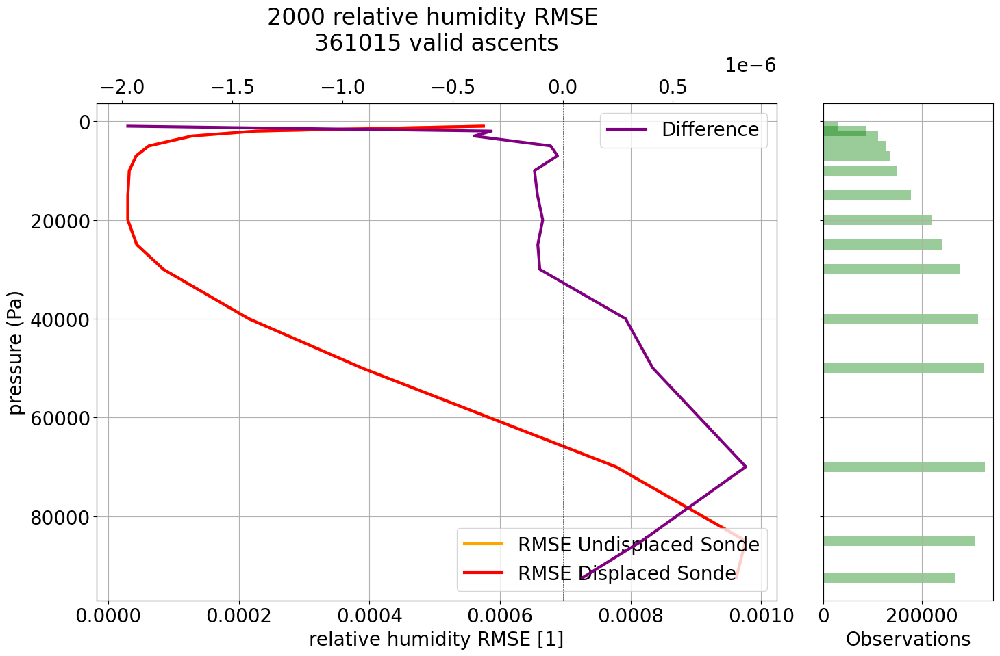

In [8]:
path =  './era5_humidity_fc_2000_rmse_data.p' # './pre_calculated_rms data/era5_v_fc_2000_rmse_data.p'
var = 'relative humidity'
unit = '1'
year = '2000'
single_plot_year_rmse(path, year, var, unit)


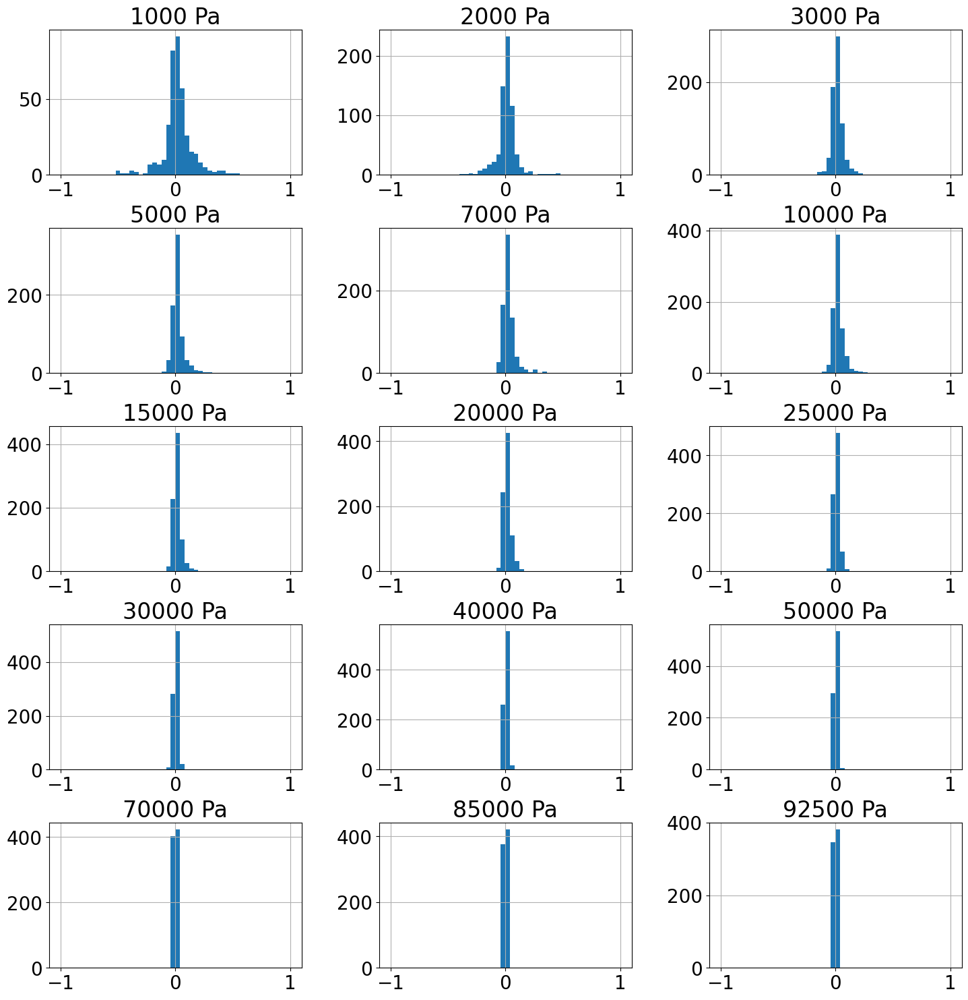

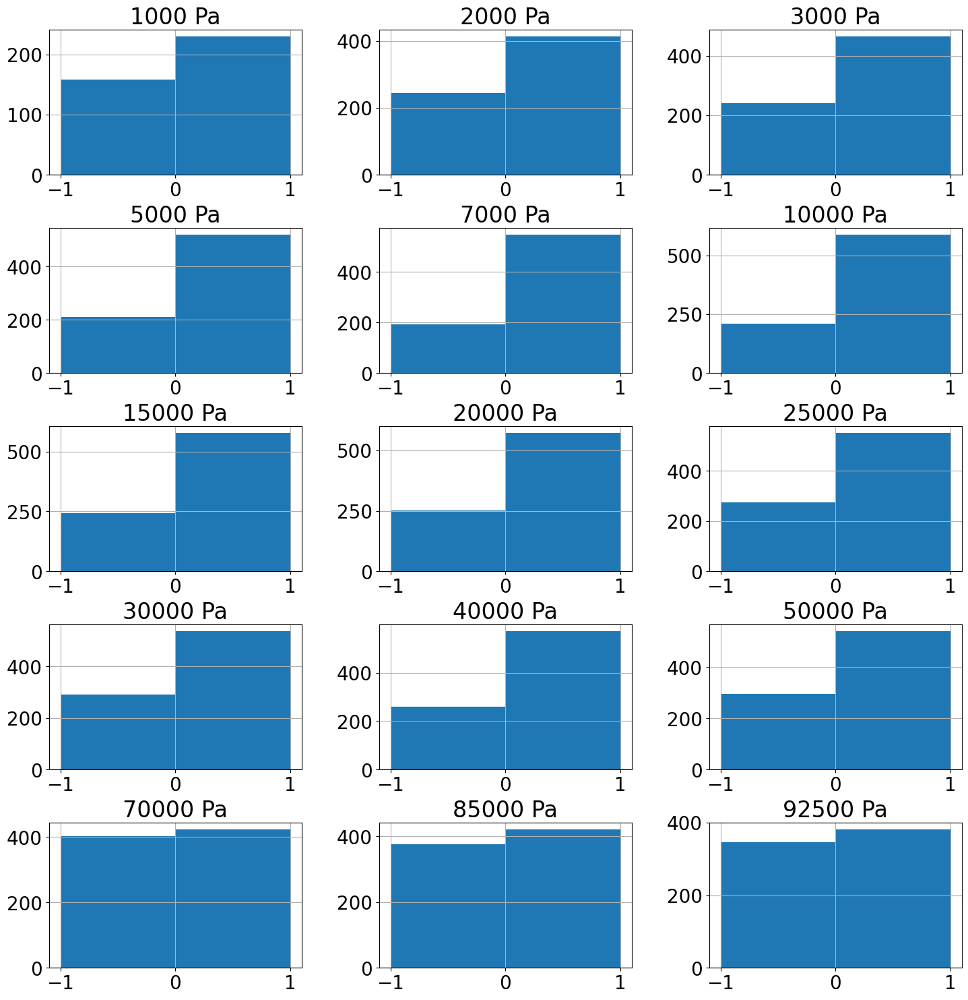

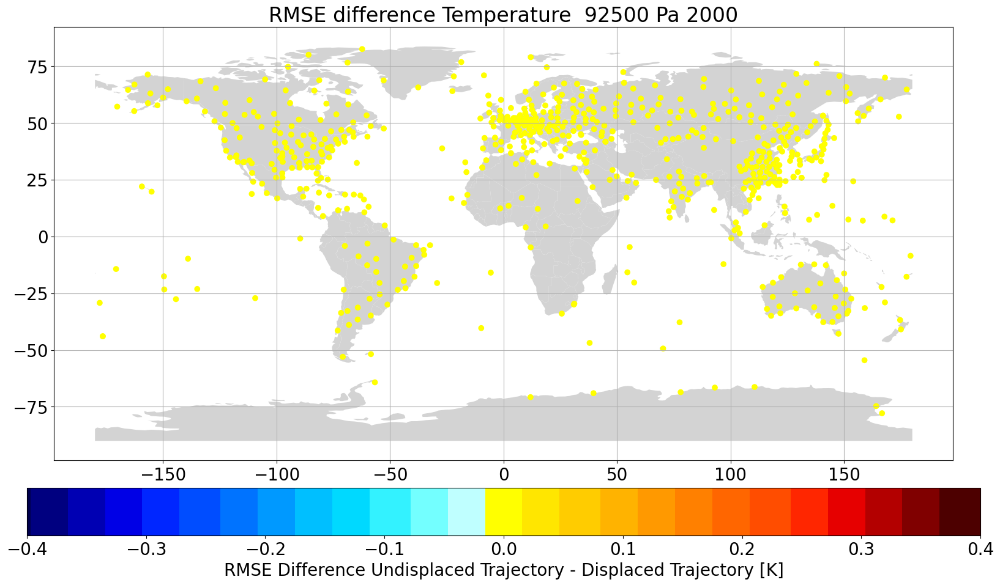

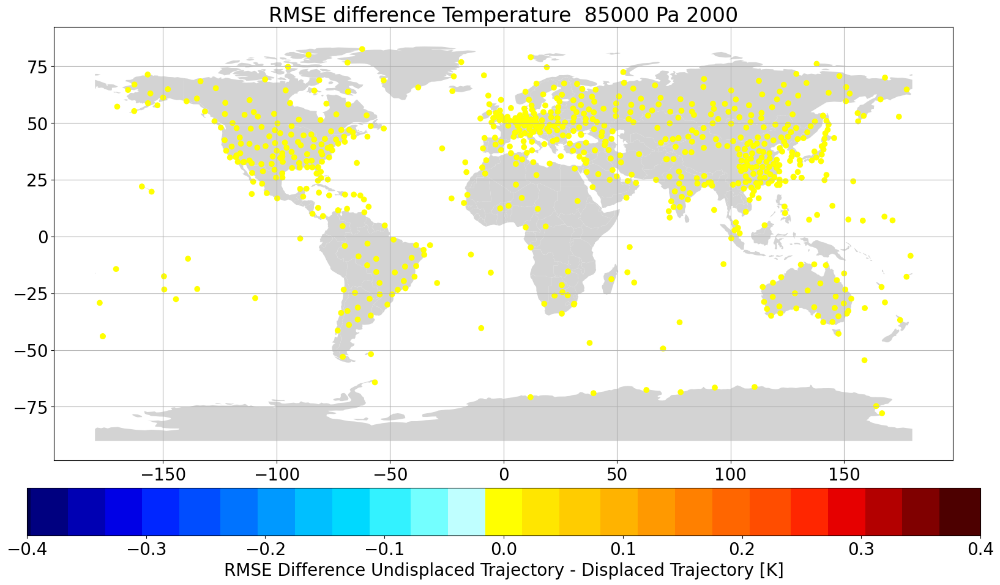

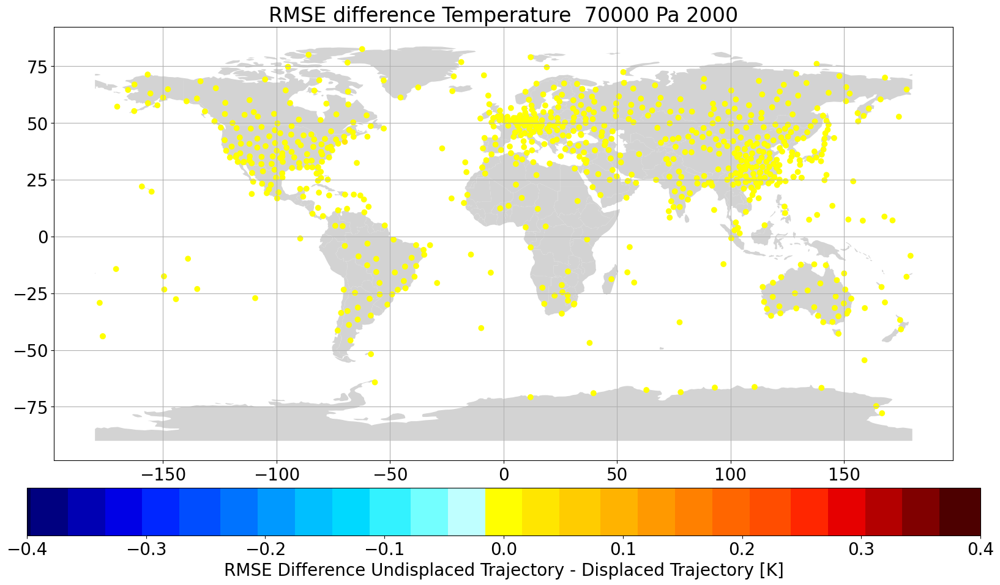

...

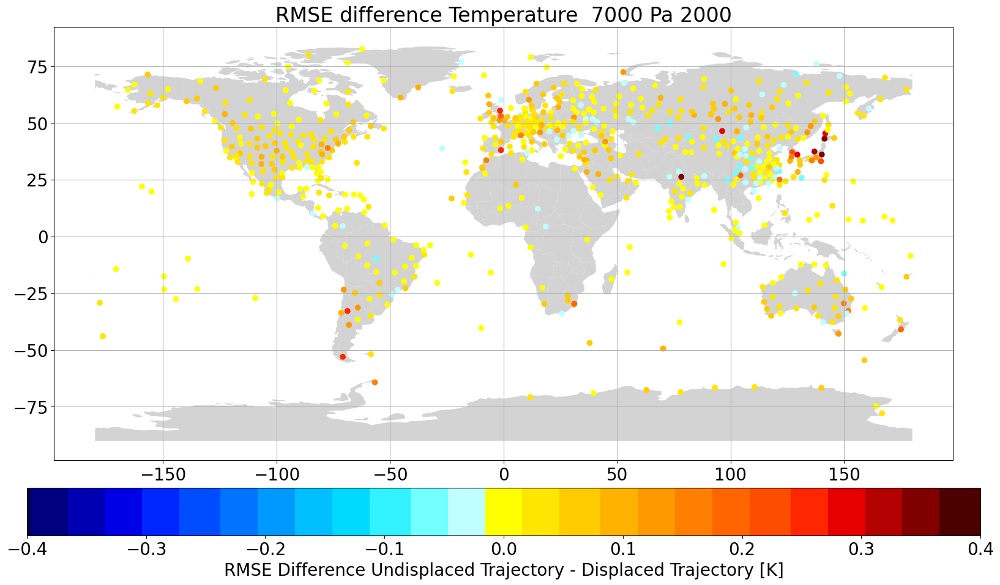

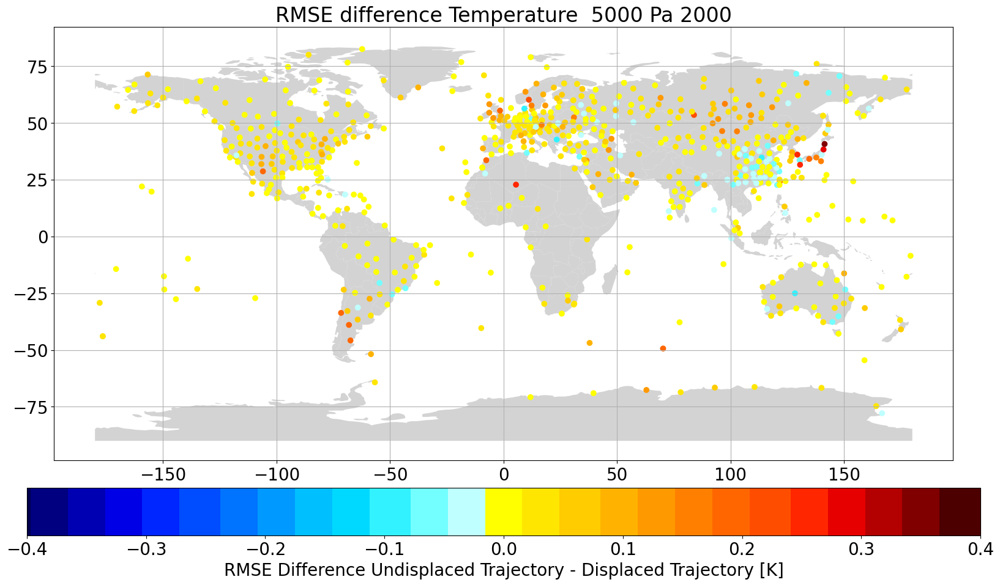

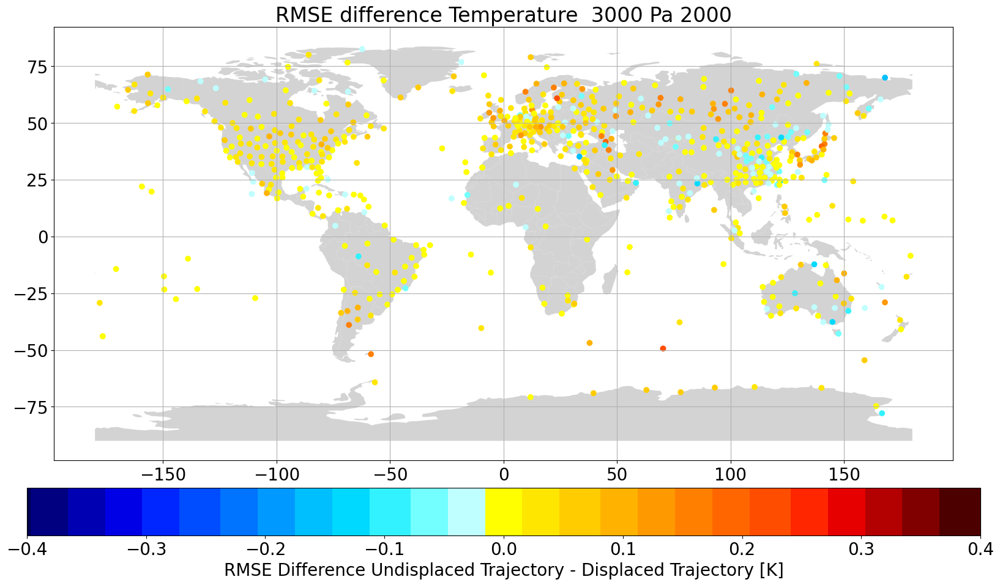

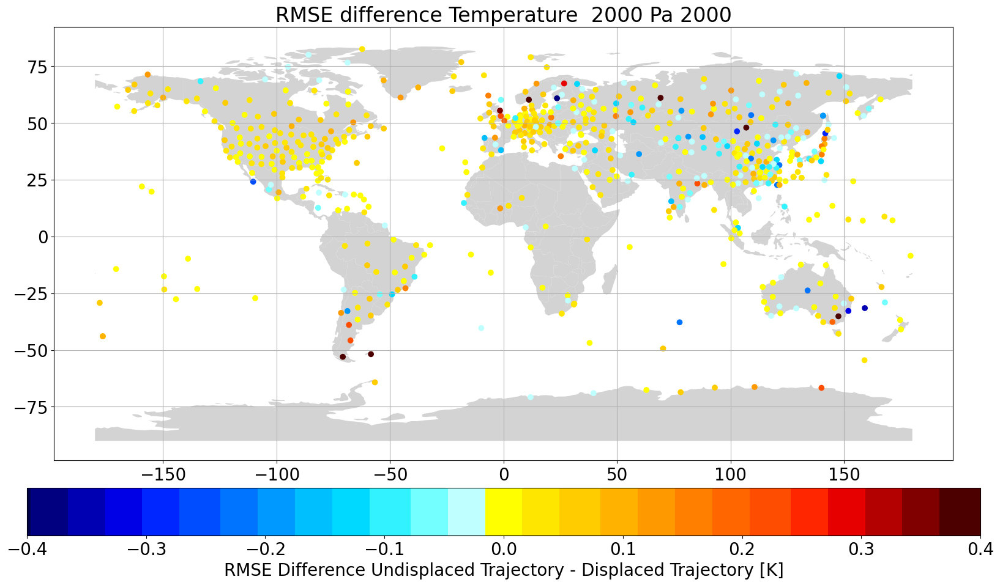

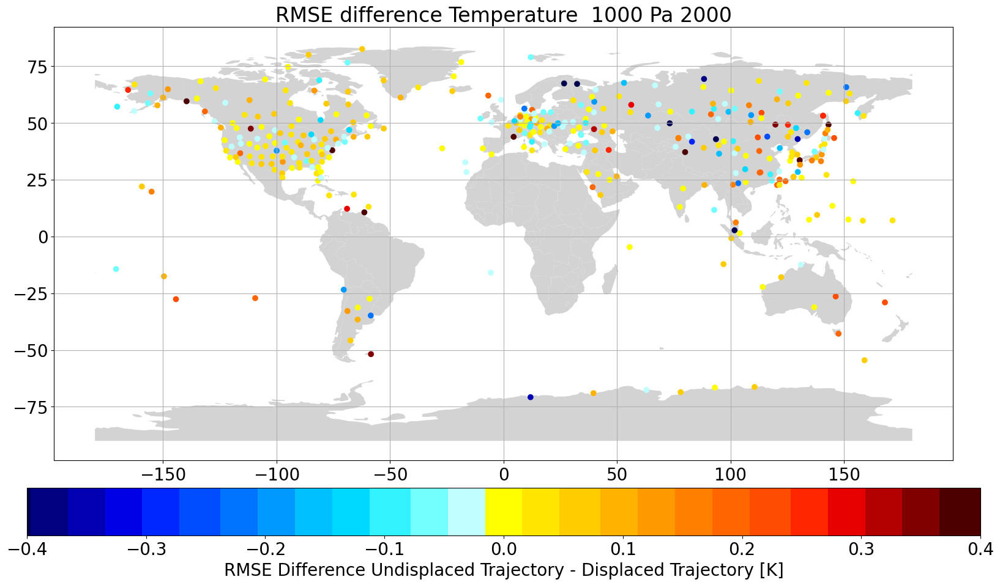

In [22]:
path =  './rmse_fc_world_outlier_cleaned_stat_info/era5_temperature_fc_2000_rmse_data.p'
var = 'Temperature'
unit = 'K'
year = '2000'
# single_plot_year_rmse(path, year, var, unit)
diffs, difflist = plot_year_rmse(path, year)



diffarray = np.array(difflist)

outlier_cleaned_data = np.empty_like(diffarray)
outlier_cleaned_dict = copy.deepcopy(diffs)
limit = [1,99]
for i in range(np.shape(diffarray)[-1]):
    data = diffarray[:, i]
    outlier_drop = np.nanpercentile(data, limit)
    data[data < outlier_drop[0]] = np.nan
    data[data > outlier_drop[1]] = np.nan
    outlier_cleaned_data[:, i] = data
    
    for j in diffs:
        if (diffs[j][i] < outlier_drop[0]) or (diffs[j][i] > outlier_drop[1]):
            outlier_cleaned_dict[j][i] = np.nan
            
    
stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
fig, ax = maplt.subplots(5, 3, figsize = (15,15))
fig.tight_layout()
x = 0
y = 0
for i in range(0,15,1):
    if y == 3:
        x += 1
        y = 0
    ax[x][y].hist(outlier_cleaned_data[:, i], 50, range=(-1,1))
    ax[x][y].set_title(str(stdplevs[i]) + ' Pa')
    ax[x][y].grid()
    
    y += 1
# fig.show()
fig.savefig("RMSE_difference_"+var+"_hist_" + str(year) + '.png')


stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
fig, ax = maplt.subplots(5, 3, figsize = (15,15))
fig.tight_layout()
x = 0
y = 0
for i in range(0,15,1):
    if y == 3:
        x += 1
        y = 0
    ax[x][y].hist(outlier_cleaned_data[:, i], 2, range=(-1,1))
    ax[x][y].set_title(str(stdplevs[i]) + ' Pa')
    ax[x][y].grid()
    y += 1
# fig.show()
fig.savefig("RMSE_difference_"+var+"_binary_hist_" + str(year) + '.png')


def plt_world_map(lla, pl ,year):    
    fig, ax = plt.subplots(figsize=(18,10))# plot map on axis
    countries = gpd.read_file(  
    #      gpd.datasets.get_path("naturalearth_lowres"))countries[countries["name"] == "Australia"].plot(color="lightgrey",
    #                                                  ax=ax)# parse dates for plot's title
        gpd.datasets.get_path("naturalearth_lowres")).plot(color="lightgrey", ax=ax)# parse dates for plot's title
    plt1 = ax.scatter(x=lla["longitude"], y=lla["latitude"],
                c=lla["diff"], 
                cmap= cmnew,
                vmin=-0.4, vmax=0.4, #edgecolor='k',
              )
    ax.set_title("RMSE difference "+var+" " + ' ' + str(pl) + ' Pa ' + str(year))
    ax.grid(b=True, alpha=1)
    plt.colorbar(plt1, orientation='horizontal', shrink=0.9, pad=0.05, label='RMSE Difference Undisplaced Trajectory - Displaced Trajectory ['+unit+']')
    plt.tight_layout()
    plt.show()
    fig.savefig("RMSE_difference_"+var+"_" + str(pl) + '_Pa_' + str(year) + '.png')
    plt.close()
    
with open('/users/staff/uvoggenberger/scratch/hug/config/active.json') as fp:
    active = json.load(fp)
stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
diff_plot_input = {}
for p in range(len(stdplevs)):
    diff_plot_input[stdplevs[p]] = [[],[],[]]
    for i in diffs:
        for a in active:
            if i in a:
                if not np.isnan(diffs[i][p]):
                    diff_plot_input[stdplevs[p]][0].append(outlier_cleaned_dict[i][p])
                    diff_plot_input[stdplevs[p]][1].append(active[a][2])
                    diff_plot_input[stdplevs[p]][2].append(active[a][3])
                break

stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
for i in np.flip(stdplevs):
    df = pd.DataFrame(np.transpose(np.array(diff_plot_input[i])), columns =['diff', 'latitude', 'longitude'])
    plt_world_map(df, i, '2000')

In [34]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx]

def datetime_to_seconds(dates, ref='1900-01-01T00:00:00'):
    """ from datetime64 to seconds since 1900-01-01 00:00:00"""
    return ((dates - np.datetime64(ref)) / np.timedelta64(1, 's')).astype(np.int64)

def seconds_to_datetime(seconds, ref='1900-01-01'):
    """ from seconds to datetime64 """
    seconds = np.asarray(seconds)
    return pd.to_datetime(seconds, unit='s', origin=ref)

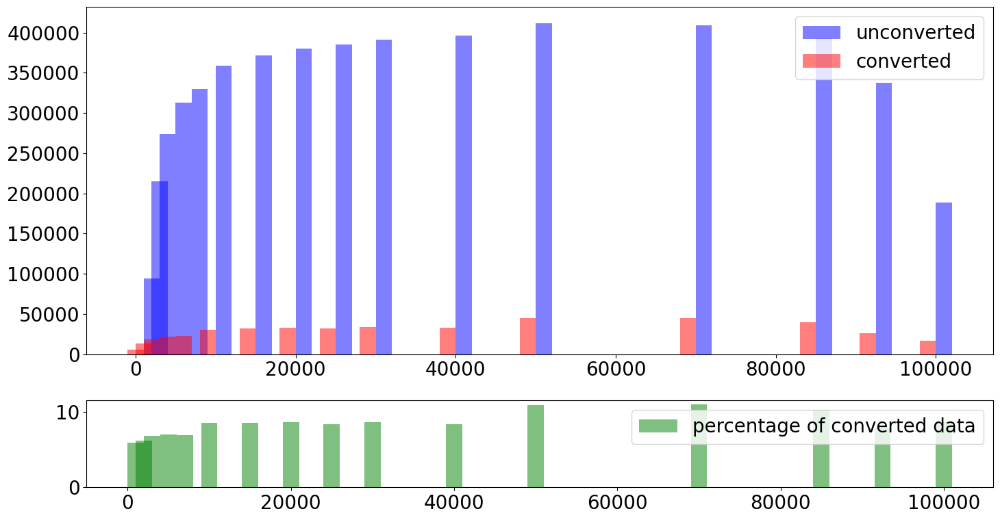

*** SIGTERM received at time=1669794762 on cpu 2 ***
PC: @     0x7f45377cfa07  (unknown)  epoll_wait
    @     0x7f4538201ce0  (unknown)  (unknown)
    @           0x74f4e0  (unknown)  (unknown)
[2022-11-30 08:52:42,984 E 3687047 3687047] logging.cc:361: *** SIGTERM received at time=1669794762 on cpu 2 ***
[2022-11-30 08:52:42,984 E 3687047 3687047] logging.cc:361: PC: @     0x7f45377cfa07  (unknown)  epoll_wait
[2022-11-30 08:52:42,987 E 3687047 3687047] logging.cc:361:     @     0x7f4538201ce0  (unknown)  (unknown)
[2022-11-30 08:52:42,990 E 3687047 3687047] logging.cc:361:     @           0x74f4e0  (unknown)  (unknown)


In [85]:
stats = glob.glob('/mnt/users/scratch/leo/scratch/converted_v9/newindex/0-2000*.nc')[:]
df_first = True
for conv_file in stats:
#     conv_file = '/mnt/users/scratch/leo/scratch/converted_v9/newindex/0-20001-0-11035_CEUAS_merged_v1.nc'
    df_dict = {}
    h_df_dict = {}
    year = 2000
    dt_from = datetime_to_seconds(np.datetime64(str(year)+'-01-01'))
    dt_to = datetime_to_seconds(np.datetime64(str(year)+'-12-31'))


    with h5py.File(conv_file, 'r') as file:
        rts = file['recordindices']['recordtimestamp'][:]
        idx = np.where(np.logical_and((rts >= dt_from), (rts <= dt_to)))[0]
        if len(idx) == 0:
            continue
        try:
            h_idx = file['recordindices']['140'][idx]
            t_idx = file['recordindices']['126'][idx]
        except:
            continue
        plevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500,100000]


        mask = file['observations_table']['z_coordinate'][t_idx[0]:t_idx[-1]]
        mask = np.isin(mask,plevs)

        h_mask = file['observations_table']['z_coordinate'][h_idx[0]:h_idx[-1]]
        h_mask = np.isin(h_mask,plevs)

        t_len = len(mask[mask == True])

        df_dict['z_coordinate'] = list(file['observations_table']['z_coordinate'][t_idx[0]:t_idx[-1]][mask])
        df_dict['date_time'] = list(file['observations_table']['date_time'][t_idx[0]:t_idx[-1]][mask])
    #             df_dict['observation_value'] = list(file['observations_table']['observation_value'][t_idx[0]:t_idx[-1]][mask])
        df_dict['latitude'] = list(file['observations_table']['latitude'][t_idx[0]:t_idx[-1]][mask])
        df_dict['longitude'] = list(file['observations_table']['longitude'][t_idx[0]:t_idx[-1]][mask])
        repid = np.asarray(file['observations_table']['report_id'][t_idx[0]:t_idx[-1]][mask])
        df_dict['report_id'] = list(repid.view('|S{}'.format(repid.shape[1])).flatten().astype(str))

    #     df_dict['RASE_bias_estimate'] = list(file['advanced_homogenisation']['RASE_bias_estimate'][t_idx[0]:t_idx[-1]][mask])
    #     df_dict['latitude_displacement'] = list(file['advanced_homogenisation']['latitude_displacement'][t_idx[0]:t_idx[-1]][mask])
    #     df_dict['longitude_displacement'] = list(file['advanced_homogenisation']['longitude_displacement'][t_idx[0]:t_idx[-1]][mask])
    #     df_dict['time_since_launch'] = list(file['advanced_homogenisation']['time_since_launch'][t_idx[0]:t_idx[-1]][mask])

        h_df_dict['z_coordinate'] = list(file['observations_table']['z_coordinate'][h_idx[0]:h_idx[-1]][h_mask])
        h_df_dict['date_time'] = list(file['observations_table']['date_time'][h_idx[0]:h_idx[-1]][h_mask])
        h_df_dict['observation_value'] = list(file['observations_table']['observation_value'][h_idx[0]:h_idx[-1]][h_mask])
        h_df_dict['conversion_flag'] = list(file['observations_table']['conversion_flag'][h_idx[0]:h_idx[-1]][h_mask])

        df_dict['variable'] = ['v']*t_len

        df_dict['date_time'] = seconds_to_datetime(df_dict['date_time'])
        df = pd.DataFrame.from_dict(df_dict)

        h_df_dict['date_time'] = seconds_to_datetime(h_df_dict['date_time'])
        h_df = pd.DataFrame.from_dict(h_df_dict)

        # put dfs together:
        df = df.merge(h_df, how='inner', on=['date_time','z_coordinate'])

        if df_first:
            df_out = df
#             print(len(df_out))
            df_first = False
        else:
            df_out = pd.concat([df_out, df])
#             print(len(df_out))

cf0 = []
unc = []
cf_interm = df_out[df_out.conversion_flag == 0]
un_interm = df_out
for i in [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500,100000]:
    cf0.append(len(cf_interm[cf_interm.z_coordinate == i]))
    unc.append(len(un_interm[un_interm.z_coordinate == i]))
    
cf0 = np.array(cf0)
unc = np.array(unc)

stdplevs = np.array([1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500, 100000])
fig, ax = maplt.subplots(2, 1, figsize = (15,8), gridspec_kw={'height_ratios': [4, 1]},)

ax[0].bar(stdplevs+1000, unc, width=2000, color='b', align='center', label = 'unconverted', alpha = 0.5)
ax[0].bar(stdplevs-1000, cf0, width=2000, color='r', align='center', label = 'converted', alpha = 0.5)
ax[0].legend()
ax[1].bar(stdplevs, 100/unc*cf0, width=2000, color='g', align='center', label = 'percentage of converted data', alpha = 0.5)
ax[1].legend()
plt.tight_layout()
plt.show()

# 0-20000-0-24688
## Ojmjakon
## RU

In [4]:
with open('./era5_u_fc_1980_rmse_data_500_only.p', 'rb') as file:
    data = pickle.load(file)
    
print(np.shape(data))    
for i in data[:]:
#     for j in range(len(names)):
    j = 0
    val = i[j][50000]
    if len(val) > 0:
#         print( np.nanmin(val))
        if np.nanmax(np.abs(val)) > 500:
            print(np.nanmax(val), np.nanmin(val), i[9][50000][0])
#             print(i)
        

(5181, 10)
37.19344139099121 -502.76180362701416 37055
151.05822134017944 -51882.3335621357 24688


In [5]:
request={
    'date': '19800101-19801231',
    'statid': '24688',
    "format": "csv",
#     "optional": ['latitude_displacement', 'longitude_displacement'],
#     "pressure_level":['30000'],
    "observed_variable": [
#         "air_temperature",
#         "relative_humidity",
        "u_component_of_wind",
        "v_component_of_wind"
    ],
}

df = eua.vm_request_wrapper(request , overwrite=True, vm_url='http://127.0.0.1:8007')
df.date_time = pd.to_datetime(df.date_time, utc=None).dt.tz_localize(None)
display(df) #= 

,date_time,latitude,longitude,primary_id,report_id,z_coordinate,variable,observation_value
0,1980-01-01 00:00:00,63.270000,143.149994,0-20000-0-24688,10000001200,7000.0,eastward_wind_speed,12.212965
1,1980-01-01 00:00:00,63.270000,143.149994,0-20000-0-24688,10000001200,10000.0,eastward_wind_speed,7.778174
2,1980-01-01 00:00:00,63.270000,143.149994,0-20000-0-24688,10000001200,15000.0,eastward_wind_speed,5.071419
3,1980-01-01 00:00:00,63.270000,143.149994,0-20000-0-24688,10000001200,20000.0,eastward_wind_speed,-1.562834
4,1980-01-01 00:00:00,63.270000,143.149994,0-20000-0-24688,10000001200,25000.0,eastward_wind_speed,4.167556
...,...,...,...,...,...,...,...,...
25479,1980-12-31 12:00:00,63.270000,143.149994,0-20000-0-24688,10000002633,85000.0,northward_wind_speed,-0.984808
25480,1980-12-31 12:00:00,63.270000,143.149994,0-20000-0-24688,10000002633,93900.0,northward_wind_speed,-0.000000
25481,1980-12-31 18:00:00,63.470001,142.800003,0-20000-0-24688,10000002634,50000.0,northward_wind_speed,4.503332
25482,1980-12-31 18:00:00,63.470001,142.800003,0-20000-0-24688,10000002634,70000.0,northward_wind_speed,0.766044


In [6]:
df[df.observation_value > 200]

,date_time,latitude,longitude,primary_id,report_id,z_coordinate,variable,observation_value
3435,1980-04-17 12:00:00,63.270000,143.149994,0-20000-0-24688,10000001618,50000.0,eastward_wind_speed,51880.000000
6438,1980-07-11 12:00:00,63.470001,142.800003,0-20000-0-24688,10000001946,50000.0,eastward_wind_speed,300.000000
7281,1980-08-05 18:00:00,63.270000,143.149994,0-20000-0-24688,10000002047,22400.0,eastward_wind_speed,210.571823
7860,1980-08-21 06:00:00,63.470001,142.800003,0-20000-0-24688,10000002108,50000.0,eastward_wind_speed,230.000000
16177,1980-04-17 12:00:00,63.270000,143.149994,0-20000-0-24688,10000001618,50000.0,northward_wind_speed,51880.000000
19180,1980-07-11 12:00:00,63.470001,142.800003,0-20000-0-24688,10000001946,50000.0,northward_wind_speed,300.000000
20602,1980-08-21 06:00:00,63.470001,142.800003,0-20000-0-24688,10000002108,50000.0,northward_wind_speed,230.000000
24527,1980-12-07 18:00:00,63.270000,143.149994,0-20000-0-24688,10000002537,7220.0,northward_wind_speed,203.012939


In [28]:
limit = [1,99]
outlier_drop = np.nanpercentile(rmse_sum_shbase_sonde[k], limit)
rmse_sum_shbase_sonde[k]  = np.array(rmse_sum_shbase_sonde[k])
rmse_sum_shbase_sonde[k][np.logical_and(rmse_sum_shbase_sonde[k] < outlier_drop[0], rmse_sum_shbase_sonde[k] > outlier_drop[1])] = np.nan
with open('./era5_u_fc_1980_rmse_data_500_only.p', 'rb') as file:
    data = pickle.load(file)
    
print(np.shape(data))    
for i in data[:]:
#     for j in range(len(names)):
    j = 0
    val = i[j][50000]
    if len(val) > 0:
#         print( np.nanmin(val))
        if np.nanmax(np.abs(val)) > 500:
            print(np.nanmax(val), np.nanmin(val), i[9][50000][0])
        

IndexError: list index out of range

In [44]:
rmse_sum_shbase_sonde, rmse_sum_shbase_adjsonde, rmse_sum_shdisp_sonde, rmse_sum_shdisp_adjsonde, rms_sum_shbase, rms_sum_adjsonde, rms_sum_sonde, rms_sum_shdisp, rms_sum_dispminusbase, stats = copy.deepcopy(data[0])
for i in data[1:]:
    if not (np.shape(i[0][50000]) == 0):
        for k in [50000]: # [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]:
            rmse_sum_shbase_sonde[k]  = rmse_sum_shbase_sonde[k] + i[0][k]
            rmse_sum_shbase_adjsonde[k] = rmse_sum_shbase_adjsonde[k] + i[1][k]
            rmse_sum_shdisp_sonde[k] = rmse_sum_shdisp_sonde[k] + i[2][k]
            rmse_sum_shdisp_adjsonde[k] = rmse_sum_shdisp_adjsonde[k] + i[3][k]
            rms_sum_shbase[k] = rms_sum_shbase[k] + i[4][k]
            rms_sum_adjsonde[k] =  rms_sum_adjsonde[k] + i[5][k]
            rms_sum_sonde[k] = rms_sum_sonde[k] + i[6][k]
            rms_sum_shdisp[k] =  rms_sum_shdisp[k] + i[7][k]
            rms_sum_dispminusbase[k] = rms_sum_dispminusbase[k] + i[8][k]
            stats[k] = stats[k] + i[9][k]

In [61]:
limit = [1,99]
k = 50000
outlier_drop = np.nanpercentile(rmse_sum_shbase_sonde[k], limit)
rmse_sum_shbase_sonde[k]  = np.array(rmse_sum_shbase_sonde[k])
rmse_sum_shbase_sonde[k][(rmse_sum_shbase_sonde[k] < outlier_drop[0])] = np.nan
rmse_sum_shbase_sonde[k][(rmse_sum_shbase_sonde[k] > outlier_drop[1])] = np.nan

In [58]:
rmse_sum_shbase_sonde[k][(rmse_sum_shbase_sonde[k] < outlier_drop[0])] 

array([-11.94744909, -11.76212025, -17.00371031, ...,  -9.94531798,
       -13.83219337, -13.13610268])

In [56]:
outlier_drop[0]

-8.906148090852875

In [62]:
np.nanmin(rmse_sum_shbase_sonde[50000])

-8.90611457824707

In [20]:
with open('./rmse_fc/era5_u_fc_1990_rmse_data.p', 'rb') as file:
    data = pickle.load(file)
    
print(np.shape(data))

names = ['rmse_sum_shbase_sonde', 'rmse_sum_shbase_adjsonde', 'rmse_sum_shdisp_sonde', 'rmse_sum_shdisp_adjsonde', 'rms_sum_shbase', 'rms_sum_adjsonde', 'rms_sum_sonde', 'rms_sum_shdisp', 'rms_sum_dispminusbase']
di = {}
for i in names:
    di[i] = 0
    
for i in data[:]:
    for j in range(len(names)):
        val = i[j][50000]
        if len(val) > 0:
            absval = np.nanmax(np.abs(val))
            if absval > di[names[j]]:
                di[names[j]] = absval
print(di)
        

(5181, 9)
{'rmse_sum_shbase_sonde': 399.28108525276184, 'rmse_sum_shbase_adjsonde': 399.06322026252747, 'rmse_sum_shdisp_sonde': 399.28080574896535, 'rmse_sum_shdisp_adjsonde': 399.062940758731, 'rms_sum_shbase': 65.67843627929688, 'rms_sum_adjsonde': 401.24859619140625, 'rms_sum_sonde': 401.4664611816406, 'rms_sum_shdisp': 64.59368097077218, 'rms_sum_dispminusbase': 5.878953837611462}


{'rmse_sum_shbase_sonde': 404.3820171356201, 'rmse_sum_shbase_adjsonde': 405.7346782684326, 'rmse_sum_shdisp_sonde': 405.34096843754526, 'rmse_sum_shdisp_adjsonde': 406.69362957035776, 'rms_sum_shbase': 44.16399002075195, 'rms_sum_adjsonde': 401.3526611328125, 'rms_sum_sonde': 400.0, 'rms_sum_shdisp': 44.18293504349503, 'rms_sum_dispminusbase': 1.993935681276902}


In [15]:
%debug

> /tmp/ipykernel_2047445/2781792789.py(11)<cell line: 6>()
      9         if len(val) > 0:
     10             absval = np.abs(val)
---> 11             if absval > di[names[j]]:
     12                 di[names[j]] = absval
     13 print(di)



ipdb>  absval


array([           nan,            nan, 2.56204605e-03,            nan,
                  nan,            nan,            nan,            nan,
       7.46251106e-01, 1.70221210e+00,            nan,            nan,
       2.43413591e+00,            nan, 4.34789658e-02,            nan,
                  nan,            nan, 6.64554119e-01,            nan,
                  nan,            nan,            nan,            nan,
                  nan,            nan,            nan,            nan,
                  nan,            nan,            nan,            nan,
                  nan, 7.53026962e-01, 6.77881718e-01,            nan,
       8.24428344e+00,            nan, 4.29260832e+00,            nan,
                  nan,            nan, 5.43605804e-01,            nan,
                  nan,            nan, 3.72552533e+00,            nan,
                  nan, 2.34859949e+00,            nan, 3.72124481e+00,
                  nan,            nan,            nan,            nan,
      

ipdb>  exit


In [2]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx]

def datetime_to_seconds(dates, ref='1900-01-01T00:00:00'):
    """ from datetime64 to seconds since 1900-01-01 00:00:00"""
    return ((dates - np.datetime64(ref)) / np.timedelta64(1, 's')).astype(np.int64)

def seconds_to_datetime(seconds, ref='1900-01-01'):
    """ from seconds to datetime64 """
    seconds = np.asarray(seconds)
    return pd.to_datetime(seconds, unit='s', origin=ref)

In [20]:
import ray
ray.init(num_cpus=2)


@ray.remote
def calc_station(sid, year):
    show_date = False
    diff = True
    stat = sid
    
    compare_to = 'fc'
    maxtimediff = pd.Timedelta(hours=2)
    
    dt_from = datetime_to_seconds(np.datetime64(str(year)+'-01-01'))
    dt_to = datetime_to_seconds(np.datetime64(str(year)+'-12-31'))
    
    conv_file = glob.glob('/mnt/users/scratch/leo/scratch/converted_v9/*' + stat + '*_CEUAS_merged_v1.nc')[0]
    df_dict = {}

    stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
    rmse_sum_shbase_sonde={}
    rmse_sum_shbase_adjsonde={}
    rmse_sum_shdisp_sonde={}
    rmse_sum_shdisp_adjsonde={}
    rms_sum_shbase={}
    rms_sum_adjsonde={}
    rms_sum_sonde={}
    rms_sum_shdisp={}
    rms_sum_dispminusbase={}

    for i in stdplevs:
        rmse_sum_shbase_sonde[i] = []
        rmse_sum_shbase_adjsonde[i] = []
        rmse_sum_shdisp_sonde[i] = []
        rmse_sum_shdisp_adjsonde[i] = []
        rms_sum_shbase[i] = []
        rms_sum_adjsonde[i] = []
        rms_sum_sonde[i] = []
        rms_sum_shdisp[i] = []
        rms_sum_dispminusbase[i] = []
    try:
        with h5py.File(conv_file, 'r') as file:
            rts = file['recordindices']['recordtimestamp'][:]
            idx = np.where(np.logical_and((rts >= dt_from), (rts <= dt_to)))[0]
            if len(idx) == 0:
                print('NO DATA FOUND IN CONVERTED_V9: ', sid)
                return [rmse_sum_shbase_sonde, rmse_sum_shbase_adjsonde, rmse_sum_shdisp_sonde,
                        rmse_sum_shdisp_adjsonde, rms_sum_shbase, rms_sum_adjsonde, rms_sum_sonde,
                        rms_sum_shdisp, rms_sum_dispminusbase]

            t_idx = file['recordindices']['126'][idx]
            plevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500,100000]

            mask = file['observations_table']['z_coordinate'][t_idx[0]:t_idx[-1]]
            mask = np.isin(mask,plevs)
            t_len = len(mask[mask == True])

            df_dict['z_coordinate'] = list(file['observations_table']['z_coordinate'][t_idx[0]:t_idx[-1]][mask])
            df_dict['date_time'] = list(file['observations_table']['date_time'][t_idx[0]:t_idx[-1]][mask])
            df_dict['observation_value'] = list(file['observations_table']['observation_value'][t_idx[0]:t_idx[-1]][mask])
            df_dict['latitude'] = list(file['observations_table']['latitude'][t_idx[0]:t_idx[-1]][mask])
            df_dict['longitude'] = list(file['observations_table']['longitude'][t_idx[0]:t_idx[-1]][mask])
            repid = np.asarray(file['observations_table']['report_id'][t_idx[0]:t_idx[-1]][mask])
            df_dict['report_id'] = list(repid.view('|S{}'.format(repid.shape[1])).flatten().astype(str))

            df_dict['RASE_bias_estimate'] = list(file['advanced_homogenisation']['RASE_bias_estimate'][t_idx[0]:t_idx[-1]][mask])
            df_dict['latitude_displacement'] = list(file['advanced_homogenisation']['latitude_displacement'][t_idx[0]:t_idx[-1]][mask])
            df_dict['longitude_displacement'] = list(file['advanced_homogenisation']['longitude_displacement'][t_idx[0]:t_idx[-1]][mask])
            df_dict['time_since_launch'] = list(file['advanced_homogenisation']['time_since_launch'][t_idx[0]:t_idx[-1]][mask])

            df_dict['variable'] = ['air_temperature']*t_len

            df_dict['date_time'] = seconds_to_datetime(df_dict['date_time'])
            df = pd.DataFrame.from_dict(df_dict)
    except:
        print('NO DATA FOUND IN CONVERTED_V9: ', sid)
        return [rmse_sum_shbase_sonde, rmse_sum_shbase_adjsonde, rmse_sum_shdisp_sonde,
                rmse_sum_shdisp_adjsonde, rms_sum_shbase, rms_sum_adjsonde, rms_sum_sonde,
                rms_sum_shdisp, rms_sum_dispminusbase]
    df = df.dropna()
    if len(df) == 0:
        print('NO DATA FOUND IN CONVERTED_V9: ', sid)
        return [rmse_sum_shbase_sonde, rmse_sum_shbase_adjsonde, rmse_sum_shdisp_sonde,
                rmse_sum_shdisp_adjsonde, rms_sum_shbase, rms_sum_adjsonde, rms_sum_sonde,
                rms_sum_shdisp, rms_sum_dispminusbase]

    for mon in [1,2,3,4,5,6,7,8,9,10,11,12]:

        df_mon = df[df.date_time.dt.month == mon]
    #     display(df_mon)
        t0 = time.time()
        if compare_to == 'fc':
            files = glob.glob('/mnt/scratch/scratch/leo/scratch/era5/gridded/era5fct.'+str(year)+str(mon).zfill(2)+'*.130.nc')[0]
        else:
            files = glob.glob('/mnt/scratch/scratch/leo/scratch/era5/gridded/era5t.'+str(year)+str(mon).zfill(2)+'*.130.nc')[0]
        ds_fc = xr.load_dataset(files)
        print('loading era5 data: ', time.time() - t0)
        t0 = time.time()

        t0 = time.time()       
        for day in df_mon.date_time.drop_duplicates()[:]:

            input_data = df_mon[df_mon.date_time == day]
            ds_fc_time = ds_fc.sel(time=day, method='nearest')
            print(day, pd.Timestamp(ds_fc_time.time.values))
            if (pd.Timestamp(ds_fc_time.time.values) - day) > maxtimediff:
                continue
            t_list = []
            for i in np.array(ds_fc_time.level): #10,20,...,1000
                step = find_nearest(input_data.z_coordinate, i*100)
                input_data_step = input_data[input_data.z_coordinate == step]
                station_lat = input_data.latitude.iloc[0] + np.array(input_data_step.latitude_displacement)[0]
                station_lon = input_data.longitude.iloc[0] + np.array(input_data_step.longitude_displacement)[0]
                lon = station_lon
                if lon < 0:
                    lon = 360.+lon
                ds_now = ds_fc_time.interp(latitude=[station_lat], longitude=[lon], method="linear")
                t = ds_now.t.sel(level = i)
                t_list.append(float(t))

            p_ml = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500,100000]
            lon = input_data.longitude.iloc[0]
            if lon < 0:
                lon = 360.+lon
            base_t = np.array(ds_fc_time.interp(latitude=[input_data.latitude.iloc[0]], longitude=[lon], method="linear").t)
            for i in range(len(stdplevs)):
                if np.abs(stdplevs[i] - find_nearest(input_data.z_coordinate,stdplevs[i])) > 500:
                    rmse_sum_shbase_sonde[stdplevs[i]].append(np.nan)
                    rmse_sum_shbase_adjsonde[stdplevs[i]].append(np.nan)
                    rmse_sum_shdisp_sonde[stdplevs[i]].append(np.nan)
                    rmse_sum_shdisp_adjsonde[stdplevs[i]].append(np.nan)
                    rms_sum_shbase[stdplevs[i]].append(np.nan)
                    rms_sum_adjsonde[stdplevs[i]].append(np.nan)
                    rms_sum_sonde[stdplevs[i]].append(np.nan)
                    rms_sum_shdisp[stdplevs[i]].append(np.nan)
                    rms_sum_dispminusbase[stdplevs[i]].append(np.nan)

                else:
                    sq_t = np.squeeze(base_t)
                    t_base = float(sq_t[p_ml == find_nearest(p_ml,stdplevs[i])])
                    t_disp = float(np.array(t_list)[p_ml == find_nearest(p_ml,stdplevs[i])])
                    input_data_step = input_data[input_data.z_coordinate == find_nearest(input_data.z_coordinate, stdplevs[i])]
                    t_sonde = float(input_data_step.observation_value)
        #             t_adjsonde = float(input_data_step.temperature) - float(input_data_step['fg_depar@body']) - float(input_data_step['an_depar@body'])
                    t_adjsonde = float(input_data_step.observation_value - input_data_step.RASE_bias_estimate)# - float(input_data_step['an_depar@body'])

                    rmse_sum_shbase_sonde[stdplevs[i]].append(t_base - t_sonde)
                    rmse_sum_shbase_adjsonde[stdplevs[i]].append(t_base - t_adjsonde)
                    rmse_sum_shdisp_sonde[stdplevs[i]].append(t_disp - t_sonde)
                    rmse_sum_shdisp_adjsonde[stdplevs[i]].append(t_disp - t_adjsonde)
                    rms_sum_shbase[stdplevs[i]].append(t_base)
                    rms_sum_adjsonde[stdplevs[i]].append(t_adjsonde)
                    rms_sum_sonde[stdplevs[i]].append(t_sonde)
                    rms_sum_shdisp[stdplevs[i]].append(t_disp)
                    rms_sum_dispminusbase[stdplevs[i]].append(t_disp-t_base)

        print('calculating mon: ',mon, time.time() - t0)
    return [rmse_sum_shbase_sonde, rmse_sum_shbase_adjsonde, rmse_sum_shdisp_sonde,
            rmse_sum_shdisp_adjsonde, rms_sum_shbase, rms_sum_adjsonde, rms_sum_sonde,
            rms_sum_shdisp, rms_sum_dispminusbase]

In [23]:
file_list = []
for sid in ['70219','11035','10393']:
    file_list.append(calc_station.remote(sid, '1970'))

In [24]:
results = ray.get(file_list)

In [52]:
a = [12,3,4]
b = [3,56,2]
# a.extend(b)

In [74]:
del rmse_sum_shbase_sonde, rmse_sum_shbase_adjsonde, rmse_sum_shdisp_sonde, rmse_sum_shdisp_adjsonde, rms_sum_shbase, rms_sum_adjsonde, rms_sum_sonde,rms_sum_shdisp, rms_sum_dispminusbase

In [75]:
rmse_sum_shbase_sonde

In [35]:
rmse_sum_shbase_sonde, rmse_sum_shbase_adjsonde, rmse_sum_shdisp_sonde, rmse_sum_shdisp_adjsonde, rms_sum_shbase, rms_sum_adjsonde, rms_sum_sonde,rms_sum_shdisp, rms_sum_dispminusbase = copy.deepcopy(results[0])
for i in results[1:]:
    for k in [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]:
        rmse_sum_shbase_sonde[k]  = rmse_sum_shbase_sonde[k] + i[0][k]
        rmse_sum_shbase_adjsonde[k] = rmse_sum_shbase_adjsonde[k] + i[1][k]
        rmse_sum_shdisp_sonde[k] = rmse_sum_shdisp_sonde[k] + i[2][k]
        rmse_sum_shdisp_adjsonde[k] = rmse_sum_shdisp_adjsonde[k] + i[3][k]
        rms_sum_shbase[k] = rms_sum_shbase[k] + i[4][k]
        rms_sum_adjsonde[k] =  rms_sum_adjsonde[k] + i[5][k]
        rms_sum_sonde[k] = rms_sum_sonde[k] + i[6][k]
        rms_sum_shdisp[k] =  rms_sum_shdisp[k] + i[7][k]
        rms_sum_dispminusbase[k] = rms_sum_dispminusbase[k] + i[8][k]
        
print('valid ascents: ', len(rms_sum_shdisp[50000]))
t0 = time.time()
rmse_shbase_sonde=[]
rmse_shbase_adjsonde=[]
rmse_shdisp_sonde=[]
rmse_shdisp_adjsonde=[]

rms_shbase=[]
rms_adjsonde=[]
rms_sonde=[]
rms_shdisp=[]
rms_dispmbase=[]

for i in range(len(stdplevs)):
    rmse_shbase_sonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shbase_sonde[stdplevs[i]])**2))))
    if show_date:    
        print('rmse_shbase_sonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shbase_sonde[-1])
    rmse_shbase_adjsonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shbase_adjsonde[stdplevs[i]])**2))))
    if show_date:    
        print('rmse_shbase_adjsonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shbase_adjsonde[-1])
    rmse_shdisp_sonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shdisp_sonde[stdplevs[i]])**2))))
    if show_date:    
        print('rmse_shdisp_sonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shdisp_sonde[-1])
    rmse_shdisp_adjsonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shdisp_adjsonde[stdplevs[i]])**2))))
    if show_date:    
        print('rmse_shdisp_adjsonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shdisp_adjsonde[-1])

    rms_shbase.append(np.sqrt(np.nanmean((np.array(rms_sum_shbase[stdplevs[i]])**2))))
    if show_date:    
        print('rms_shbase - plev: ', stdplevs[i], ' RMS: ', rms_shbase[-1])
    rms_adjsonde.append(np.sqrt(np.nanmean((np.array(rms_sum_adjsonde[stdplevs[i]])**2))))
    if show_date:    
        print('rms_adjsonde - plev: ', stdplevs[i], ' RMS: ', rms_adjsonde[-1])
    rms_sonde.append(np.sqrt(np.nanmean((np.array(rms_sum_sonde[stdplevs[i]])**2))))
    if show_date:    
        print('rms_sonde - plev: ', stdplevs[i], ' RMS: ', rms_sonde[-1])
    rms_shdisp.append(np.sqrt(np.nanmean((np.array(rms_sum_shdisp[stdplevs[i]])**2))))
    if show_date:
        print('rms_shdisp - plev: ', stdplevs[i], ' RMS: ', rms_shdisp[-1])
    rms_dispmbase.append(np.sqrt(np.nanmean((np.array(rms_sum_dispminusbase[stdplevs[i]])**2))))
    if show_date:
        print('rms_dispmbase - plev: ', stdplevs[i], ' RMS: ', rms_shdisp[-1])


print('')

fig, ax1 = maplt.subplots(figsize = (15,10))
ax1.plot(np.array(rmse_shbase_sonde),stdplevs,color='orange', label='rmse_shbase_sonde')
ax1.plot(np.array(rmse_shdisp_sonde),stdplevs, color='red', label='rmse_shdisp_sonde')

ax1_4 = ax1.twiny()
ax1_4.axvline(x=0, color='black', alpha=0.8, ls='--', lw=0.5)
if diff:
    ax1_4.plot(np.array(rmse_shbase_sonde)-np.array(rmse_shdisp_sonde),stdplevs,color='purple', label='diff')
ax1_4.plot(np.array(rms_dispmbase),stdplevs, color='green', alpha=0.3, ls='--', label='rms_disp_minus_base')

ax1_4.legend(loc='lower left')
ax1.set_ylim(ax1.get_ylim()[::-1])
ax1.set_ylabel('pressure (Pa)')
ax1.set_xlabel('Temperature RMSE')
ax1.legend(loc='upper right')
ax1.grid()

maplt.title(str(year)+' Temperature RMSE \n' + str(len(results)) + ' stations  ---  ' +str(len(rms_sum_shdisp[50000])) +' valid ascents')
maplt.savefig(str(year)+'_world_rmse_plot.png')
maplt.close()
print('RMSE calculation: ', time.time()-t0)

NameError: name 'results' is not defined

In [60]:
np.shape(rmse_sum_shbase_sonde[1000])

In [61]:
for i in results[:]:
    print(len(i[0][1000]))

# Calculate the trajectory RMSE

In [19]:
show_date = False
diff = True
stat = '70219'
compare_to = 'fc'
year = '1980'
maxtimediff = pd.Timedelta(hours=2)
dt_from = datetime_to_seconds(np.datetime64(str(year)+'-01-01'))
dt_to = datetime_to_seconds(np.datetime64(str(year)+'-12-31'))
conv_file = glob.glob('/mnt/users/scratch/leo/scratch/converted_v9/*' + stat + '*_CEUAS_merged_v1.nc')[0]
df_dict = {}

stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
rmse_sum_shbase_sonde={}
rmse_sum_shbase_adjsonde={}
rmse_sum_shdisp_sonde={}
rmse_sum_shdisp_adjsonde={}
rms_sum_shbase={}
rms_sum_adjsonde={}
rms_sum_sonde={}
rms_sum_shdisp={}
rms_sum_dispminusbase={}

for i in stdplevs:
    rmse_sum_shbase_sonde[i] = []
    rmse_sum_shbase_adjsonde[i] = []
    rmse_sum_shdisp_sonde[i] = []
    rmse_sum_shdisp_adjsonde[i] = []
    rms_sum_shbase[i] = []
    rms_sum_adjsonde[i] = []
    rms_sum_sonde[i] = []
    rms_sum_shdisp[i] = []
    rms_sum_dispminusbase[i] = []
            
with h5py.File(conv_file, 'r') as file:
    rts = file['recordindices']['recordtimestamp'][:]
    idx = np.where(np.logical_and((rts >= dt_from), (rts <= dt_to)))[0]
    if len(idx) == 0:
        print('nothing found')
#         return 1
    t_idx = file['recordindices']['126'][idx]

    plevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500,100000]
    
    mask = file['observations_table']['z_coordinate'][t_idx[0]:t_idx[-1]]
    mask = np.isin(mask,plevs)
    t_len = len(mask[mask == True])

    df_dict['z_coordinate'] = list(file['observations_table']['z_coordinate'][t_idx[0]:t_idx[-1]][mask])
    df_dict['date_time'] = list(file['observations_table']['date_time'][t_idx[0]:t_idx[-1]][mask])
    df_dict['observation_value'] = list(file['observations_table']['observation_value'][t_idx[0]:t_idx[-1]][mask])
    df_dict['latitude'] = list(file['observations_table']['latitude'][t_idx[0]:t_idx[-1]][mask])
    df_dict['longitude'] = list(file['observations_table']['longitude'][t_idx[0]:t_idx[-1]][mask])
    repid = np.asarray(file['observations_table']['report_id'][t_idx[0]:t_idx[-1]][mask])
    df_dict['report_id'] = list(repid.view('|S{}'.format(repid.shape[1])).flatten().astype(str))

    df_dict['RASE_bias_estimate'] = list(file['advanced_homogenisation']['RASE_bias_estimate'][t_idx[0]:t_idx[-1]][mask])
    df_dict['latitude_displacement'] = list(file['advanced_homogenisation']['latitude_displacement'][t_idx[0]:t_idx[-1]][mask])
    df_dict['longitude_displacement'] = list(file['advanced_homogenisation']['longitude_displacement'][t_idx[0]:t_idx[-1]][mask])
    df_dict['time_since_launch'] = list(file['advanced_homogenisation']['time_since_launch'][t_idx[0]:t_idx[-1]][mask])

    df_dict['variable'] = ['air_temperature']*t_len
    
    df_dict['date_time'] = seconds_to_datetime(df_dict['date_time'])
    df = pd.DataFrame.from_dict(df_dict)
df = df.dropna()

for mon in [1,2,3,4,5,6,7,8,9,10,11,12]:
    
    df_mon = df[df.date_time.dt.month == mon]
#     display(df_mon)
    t0 = time.time()
    if compare_to == 'fc':
        files = glob.glob('/mnt/scratch/scratch/leo/scratch/era5/gridded/era5fct.'+str(year)+str(mon).zfill(2)+'*.130.nc')[0]
    else:
        files = glob.glob('/mnt/scratch/scratch/leo/scratch/era5/gridded/era5t.'+str(year)+str(mon).zfill(2)+'*.130.nc')[0]
    ds_fc = xr.load_dataset(files)
    print('loading era5 data: ', time.time() - t0)
    t0 = time.time()

    t0 = time.time()       
    for day in df_mon.date_time.drop_duplicates()[:]:
        
        input_data = df_mon[df_mon.date_time == day]
        ds_fc_time = ds_fc.sel(time=day, method='nearest')
#         print(day, pd.Timestamp(ds_fc_time.time.values))
        if (pd.Timestamp(ds_fc_time.time.values) - day) > maxtimediff:
            continue
        t_list = []
        for i in np.array(ds_fc_time.level): #10,20,...,1000
            step = find_nearest(input_data.z_coordinate, i*100)
            input_data_step = input_data[input_data.z_coordinate == step]
            station_lat = input_data.latitude.iloc[0] + np.array(input_data_step.latitude_displacement)[0]
            station_lon = input_data.longitude.iloc[0] + np.array(input_data_step.longitude_displacement)[0]
            lon = station_lon
            if lon < 0:
                lon = 360.+lon
            ds_now = ds_fc_time.interp(latitude=[station_lat], longitude=[lon], method="linear")
            t = ds_now.t.sel(level = i)
            t_list.append(float(t))

        p_ml = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500,100000]
        lon = input_data.longitude.iloc[0]
        if lon < 0:
            lon = 360.+lon
        base_t = np.array(ds_fc_time.interp(latitude=[input_data.latitude.iloc[0]], longitude=[lon], method="linear").t)
        for i in range(len(stdplevs)):
            if np.abs(stdplevs[i] - find_nearest(input_data.z_coordinate,stdplevs[i])) > 500:
                rmse_sum_shbase_sonde[stdplevs[i]].append(np.nan)
                rmse_sum_shbase_adjsonde[stdplevs[i]].append(np.nan)
                rmse_sum_shdisp_sonde[stdplevs[i]].append(np.nan)
                rmse_sum_shdisp_adjsonde[stdplevs[i]].append(np.nan)
                rms_sum_shbase[stdplevs[i]].append(np.nan)
                rms_sum_adjsonde[stdplevs[i]].append(np.nan)
                rms_sum_sonde[stdplevs[i]].append(np.nan)
                rms_sum_shdisp[stdplevs[i]].append(np.nan)
                rms_sum_dispminusbase[stdplevs[i]].append(np.nan)

            else:
                sq_t = np.squeeze(base_t)
                t_base = float(sq_t[p_ml == find_nearest(p_ml,stdplevs[i])])
                t_disp = float(np.array(t_list)[p_ml == find_nearest(p_ml,stdplevs[i])])
                input_data_step = input_data[input_data.z_coordinate == find_nearest(input_data.z_coordinate, stdplevs[i])]
                t_sonde = float(input_data_step.observation_value)
    #             t_adjsonde = float(input_data_step.temperature) - float(input_data_step['fg_depar@body']) - float(input_data_step['an_depar@body'])
                t_adjsonde = float(input_data_step.observation_value - input_data_step.RASE_bias_estimate)# - float(input_data_step['an_depar@body'])

                rmse_sum_shbase_sonde[stdplevs[i]].append(t_base - t_sonde)
                rmse_sum_shbase_adjsonde[stdplevs[i]].append(t_base - t_adjsonde)
                rmse_sum_shdisp_sonde[stdplevs[i]].append(t_disp - t_sonde)
                rmse_sum_shdisp_adjsonde[stdplevs[i]].append(t_disp - t_adjsonde)
                rms_sum_shbase[stdplevs[i]].append(t_base)
                rms_sum_adjsonde[stdplevs[i]].append(t_adjsonde)
                rms_sum_sonde[stdplevs[i]].append(t_sonde)
                rms_sum_shdisp[stdplevs[i]].append(t_disp)
                rms_sum_dispminusbase[stdplevs[i]].append(t_disp-t_base)
                
    print('calculating mon: ',mon, time.time() - t0)

                
print('valid ascents: ', len(rms_sum_shdisp[50000]))
t0 = time.time()
rmse_shbase_sonde=[]
rmse_shbase_adjsonde=[]
rmse_shdisp_sonde=[]
rmse_shdisp_adjsonde=[]

rms_shbase=[]
rms_adjsonde=[]
rms_sonde=[]
rms_shdisp=[]
rms_dispmbase=[]

for i in range(len(stdplevs)):
    rmse_shbase_sonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shbase_sonde[stdplevs[i]])**2))))
    if show_date:    
        print('rmse_shbase_sonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shbase_sonde[-1])
    rmse_shbase_adjsonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shbase_adjsonde[stdplevs[i]])**2))))
    if show_date:    
        print('rmse_shbase_adjsonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shbase_adjsonde[-1])
    rmse_shdisp_sonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shdisp_sonde[stdplevs[i]])**2))))
    if show_date:    
        print('rmse_shdisp_sonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shdisp_sonde[-1])
    rmse_shdisp_adjsonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shdisp_adjsonde[stdplevs[i]])**2))))
    if show_date:    
        print('rmse_shdisp_adjsonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shdisp_adjsonde[-1])

    rms_shbase.append(np.sqrt(np.nanmean((np.array(rms_sum_shbase[stdplevs[i]])**2))))
    if show_date:    
        print('rms_shbase - plev: ', stdplevs[i], ' RMS: ', rms_shbase[-1])
    rms_adjsonde.append(np.sqrt(np.nanmean((np.array(rms_sum_adjsonde[stdplevs[i]])**2))))
    if show_date:    
        print('rms_adjsonde - plev: ', stdplevs[i], ' RMS: ', rms_adjsonde[-1])
    rms_sonde.append(np.sqrt(np.nanmean((np.array(rms_sum_sonde[stdplevs[i]])**2))))
    if show_date:    
        print('rms_sonde - plev: ', stdplevs[i], ' RMS: ', rms_sonde[-1])
    rms_shdisp.append(np.sqrt(np.nanmean((np.array(rms_sum_shdisp[stdplevs[i]])**2))))
    if show_date:
        print('rms_shdisp - plev: ', stdplevs[i], ' RMS: ', rms_shdisp[-1])
    rms_dispmbase.append(np.sqrt(np.nanmean((np.array(rms_sum_dispminusbase[stdplevs[i]])**2))))
    if show_date:
        print('rms_dispmbase - plev: ', stdplevs[i], ' RMS: ', rms_shdisp[-1])


print('')

fig, ax1 = maplt.subplots(figsize = (15,10))
ax1.plot(np.array(rmse_shbase_sonde),stdplevs,color='orange', label='rmse_shbase_sonde')
ax1.plot(np.array(rmse_shdisp_sonde),stdplevs, color='red', label='rmse_shdisp_sonde')

ax1_4 = ax1.twiny()
ax1_4.axvline(x=0, color='black', alpha=0.8, ls='--', lw=0.5)
if diff:
    ax1_4.plot(np.array(rmse_shbase_sonde)-np.array(rmse_shdisp_sonde),stdplevs,color='purple', label='diff')
ax1_4.plot(np.array(rms_dispmbase),stdplevs, color='green', alpha=0.3, ls='--', label='rms_disp_minus_base')

ax1_4.legend(loc='lower left')
ax1.set_ylim(ax1.get_ylim()[::-1])
ax1.set_ylabel('pressure (Pa)')
ax1.set_xlabel('Temperature RMSE')
ax1.legend(loc='upper right')
ax1.grid()

maplt.title(str(stat)+' LEVEL Temperature RMSE ')
maplt.show()
maplt.close()
print('RMSE calculation: ', time.time()-t0)


In [11]:
def trajectory_rmse (stats, year, month=False, sel_time=False, show_ascents=False, show_date=False, min_disp=0, compare_to='fc', diff=False):
    print('compare to: ', compare_to)
    maxtimediff = pd.Timedelta(hours=2)
    for stat in stats:
        t0 = time.time()
        statlist = glob.glob('/mnt/users/scratch/leo/scratch/converted_v9/*' + stat + '*_CEUAS_merged_v1.nc')
        df = eua.CDMDataset(filename = statlist[0]).to_dataframe(groups=['observations_table', 'era5fb'], variables=['latitude', 'longitude', 'observed_variable', 'observation_value', 'z_coordinate', 'date_time', 'fg_depar@body', 'an_depar@body'])
        print('reading converted_v9: ', time.time()-t0)
        t0 = time.time()
        # 2020 only
        df = df[df.date_time.dt.year == year]
        # night only -> ~ 00:00
        if sel_time:
            df = df[np.isin(df.date_time.dt.hour,time)]
        print('selecting from converted_v9: ', time.time()-t0)
        t0 = time.time()

        from scipy.signal import savgol_filter
        # stdplevs = [92500,85000,70000,50000,40000,30000,25000,20000,15000,10000,7000,5000,3000,2000,1000]
        stdplevs = [1000,2000,3000,5000,7000,10000,15000,20000,25000,30000,40000,50000,70000,85000,92500]
        rmse_sum_shbase_sonde={}
        rmse_sum_shbase_adjsonde={}
        rmse_sum_shdisp_sonde={}
        rmse_sum_shdisp_adjsonde={}
        rms_sum_shbase={}
        rms_sum_adjsonde={}
        rms_sum_sonde={}
        rms_sum_shdisp={}
        rms_sum_dispminusbase={}

        for i in stdplevs:
            rmse_sum_shbase_sonde[i] = []
            rmse_sum_shbase_adjsonde[i] = []
            rmse_sum_shdisp_sonde[i] = []
            rmse_sum_shdisp_adjsonde[i] = []
            rms_sum_shbase[i] = []
            rms_sum_adjsonde[i] = []
            rms_sum_sonde[i] = []
            rms_sum_shdisp[i] = []
            rms_sum_dispminusbase[i] = []
        
        if month == False:
            month = [1,2,3,4,5,6,7,8,9,10,11,12]
        else:
            month = [month]
        for m in month:
            print('month: ', m)
            t0 = time.time()
            if compare_to == 'fc':
                files = glob.glob('/mnt/scratch/scratch/leo/scratch/era5/gridded/era5fct.'+str(year)+str(m).zfill(2)+'*.130.nc')[0]
            else:
                files = glob.glob('/mnt/scratch/scratch/leo/scratch/era5/gridded/era5t.'+str(year)+str(m).zfill(2)+'*.130.nc')[0]
            ds_fc = xr.load_dataset(files)
            print('loading era5 data: ', time.time()-t0)
            t0 = time.time()
            df_mon = df[df.date_time.dt.month == m]
            print('selecting era5 data: ', time.time()-t0)
            t0 = time.time()
            
            for day in df_mon.date_time.drop_duplicates()[:]:
                try:
                    test = df_mon[df_mon.date_time == day]
                    if show_date:
                        print(day)

                    ds_fc_time = ds_fc.sel(time=day, method='nearest')
                    t0 = time.time()
                    if (pd.Timestamp(ds_fc_time.time.values) - day) > maxtimediff:
                        continue


                    t = test[test.observed_variable == 126]
                    t = t.rename(columns={'observation_value':'temperature'})
                    t = t.drop(columns='observed_variable')

                    u = test[test.observed_variable == 104]
                    u = u.rename(columns={'observation_value':'u'})
                    u = u.drop(columns=['observed_variable', 'fg_depar@body', 'an_depar@body'])

                    v = test[test.observed_variable == 105]
                    v = v.rename(columns={'observation_value':'v'})
                    v = v.drop(columns=['observed_variable', 'fg_depar@body', 'an_depar@body'])

                    input_data = pd.merge(t, u, on=['z_coordinate', 'latitude', 'longitude', 'date_time'])
                    input_data = pd.merge(input_data, v, on=['z_coordinate', 'latitude', 'longitude', 'date_time'])

                    input_data = input_data.dropna()
                    input_data = input_data.reindex(index=input_data.index[::-1])
                    phys_model = trj.trajectory(lat=t.latitude.iloc[0], lon=t.longitude.iloc[0], temperature=np.array(input_data.temperature), u=np.array(input_data.u), v=np.array(input_data.v), pressure=np.array(input_data.z_coordinate))
                    if (np.abs(np.nanmax(phys_model[0])) < min_disp) and (np.abs(np.nanmax(phys_model[1])) < min_disp):
        #                 print(np.nanmax(phys_model[0]), np.nanmax(phys_model[1]))
                        continue
                    input_data['z'] = np.array(trj.calc_height(np.array(input_data.temperature), np.array(input_data.z_coordinate), jump=False))
                    input_data['calc_latd'] = np.array(phys_model[0])
                    input_data['calc_lond'] = np.array(phys_model[1])
                    input_data = input_data.reindex(index=input_data.index[::-1])
                    input_data = input_data.reset_index()

                    
        #                 display(ds_fc_time)
                #     ds_fc_loc = ds_fc_time.interp(latitude=search_lat, longitude=search_lon, method='linear')
                #     df_fc_loc = ds_fc_loc.to_dataframe()

                #     display(input_data)
                    t_list = []
                    for i in np.array(ds_fc_time.level): #10,20,...,1000
                        step = find_nearest(input_data.z_coordinate, i*100)
                #         print('step - level: ', step)
                        input_data_step = input_data[input_data.z_coordinate == step]
                #         print('displacement: ', input_data_step.calc_latd)
                        station_lat = input_data.latitude[0] + np.array(input_data_step.calc_latd)[0]
                #         print(i, input_data.latitude[0], station_lat)
                        station_lon = input_data.longitude[0] + np.array(input_data_step.calc_lond)[0]
                #         print(i, input_data.longitude[0], station_lon)
                        lon = station_lon
                        if lon < 0:
                            lon = 360.+lon
                        ds_now = ds_fc_time.interp(latitude=[station_lat], longitude=[lon], method="linear")
                #         print('selected lat: ', float(ds_now.latitude))
                        t = ds_now.t.sel(level = i)
                        t_list.append(float(t))

                #     print('lat: ', input_data.latitude[0], 'lon: ', input_data.longitude[0])
                #     print(stat)
                #     print(day)
                    p_ml = [  1000,   2000,   3000,   5000,   7000,  10000,  15000,  20000,  25000,  30000,  40000,  50000,  70000,  85000,  92500, 100000]
                    lon = input_data.longitude[0]
                    if lon < 0:
                        lon = 360.+lon
                    base_t = np.array(ds_fc_time.interp(latitude=[input_data.latitude[0]], longitude=[lon], method="linear").t)
                    for i in range(len(stdplevs)):
                        if np.abs(stdplevs[i] - find_nearest(input_data.z_coordinate,stdplevs[i])) > 500:
#                             print(stdplevs[i] , find_nearest(input_data.z_coordinate,stdplevs[i]))
                            rmse_sum_shbase_sonde[stdplevs[i]].append(np.nan)
                            rmse_sum_shbase_adjsonde[stdplevs[i]].append(np.nan)
                            rmse_sum_shdisp_sonde[stdplevs[i]].append(np.nan)
                            rmse_sum_shdisp_adjsonde[stdplevs[i]].append(np.nan)
                            rms_sum_shbase[stdplevs[i]].append(np.nan)
                            rms_sum_adjsonde[stdplevs[i]].append(np.nan)
                            rms_sum_sonde[stdplevs[i]].append(np.nan)
                            rms_sum_shdisp[stdplevs[i]].append(np.nan)
                            rms_sum_dispminusbase[stdplevs[i]].append(np.nan)

                        else:
                            sq_t = np.squeeze(base_t)
                            t_base = float(sq_t[p_ml == find_nearest(p_ml,stdplevs[i])])
                            t_disp = float(np.array(t_list)[p_ml == find_nearest(p_ml,stdplevs[i])])
                            input_data_step = input_data[input_data.z_coordinate == find_nearest(input_data.z_coordinate, stdplevs[i])]
                            t_sonde = float(input_data_step.temperature)
                #             t_adjsonde = float(input_data_step.temperature) - float(input_data_step['fg_depar@body']) - float(input_data_step['an_depar@body'])
                            t_adjsonde = float(input_data_step.temperature)# - float(input_data_step['an_depar@body'])

                            rmse_sum_shbase_sonde[stdplevs[i]].append(t_base - t_sonde)
                            rmse_sum_shbase_adjsonde[stdplevs[i]].append(t_base - t_adjsonde)
                            rmse_sum_shdisp_sonde[stdplevs[i]].append(t_disp - t_sonde)
                            rmse_sum_shdisp_adjsonde[stdplevs[i]].append(t_disp - t_adjsonde)
                            rms_sum_shbase[stdplevs[i]].append(t_base)
                            rms_sum_adjsonde[stdplevs[i]].append(t_adjsonde)
                            rms_sum_sonde[stdplevs[i]].append(t_sonde)
                            rms_sum_shdisp[stdplevs[i]].append(t_disp)
                            rms_sum_dispminusbase[stdplevs[i]].append(t_disp-t_base)


                    if show_ascents:
                        fig, ax1 = maplt.subplots(1, figsize=(16, 8))
    #                         plt_sonde_t = []

    #                         for pl in stdplevs:
                        base = []
                        disp = []
                        sond = []
                        plev = []
                        for i in range(len(stdplevs)):
                            base.append(rms_sum_shbase[stdplevs[i]][-1])
                            disp.append(rms_sum_shdisp[stdplevs[i]][-1])
                            sond.append(rms_sum_sonde[stdplevs[i]][-1])
                            plev.append(stdplevs[i])

    #                             if np.abs(pl - find_nearest(input_data.z_coordinate, pl)) > 500:
    #                                 plt_sonde_t.append(np.nan)
    #                             else:
    #                                 apl = find_nearest(input_data.z_coordinate, pl)
    #                                 plt_sonde_t.append(float(input_data[input_data.z_coordinate == apl].temperature))
    #                         ax1.plot(np.squeeze(base_t), np.array(p_ml), color = 'green', alpha = 0.6, label='base tempterature')
    #                         ax1.plot(np.array(t_list), np.array(p_ml), color = 'blue', alpha = 0.2,ls = '--', label='displaced temperature')
    #                         ax1.plot(np.array(plt_sonde_t), np.array(stdplevs), color = 'red', alpha = 0.2,ls = '--', label='temperature radio sonde')

                        ax1.plot(np.array(base), np.array(plev), color = 'green', alpha = 0.6, label='base tempterature')
                        ax1.plot(np.array(disp), np.array(plev), color = 'blue', alpha = 0.2,ls = '--', label='displaced temperature')
                        ax1.plot(np.array(sond), np.array(plev), color = 'red', alpha = 0.2,ls = '--', label='temperature radio sonde')

    #                         ax1.plot(np.array(input_data.temperature), np.array(input_data.z_coordinate), color = 'red', alpha = 0.2,ls = '--', label='temperature radio sonde')
                    #     ax1.plot(np.array(input_data.temperature - input_data['an_depar@body'] ), np.array(input_data.z_coordinate), color = 'orange', alpha = 0.6, label='temperature radio sonde - an_depar')
                        ax1.set_ylabel('pressure (Pa)')
                        ax1.set_xlabel('temperature (K)')
                        ax1.tick_params(axis='y')
                        ax1.set_ylim(ax1.get_ylim()[::-1])
                        ax1.legend()
                        ax1.grid()
                        maplt.show()
                        maplt.close()
                except:
                    pass
                print('done with all days: ', time.time()-t0)
            
        print('valid ascents: ', len(rms_sum_shdisp[50000]))
        t0 = time.time()
        rmse_shbase_sonde=[]
        rmse_shbase_adjsonde=[]
        rmse_shdisp_sonde=[]
        rmse_shdisp_adjsonde=[]

        rms_shbase=[]
        rms_adjsonde=[]
        rms_sonde=[]
        rms_shdisp=[]
        rms_dispmbase=[]

        for i in range(len(stdplevs)):
            rmse_shbase_sonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shbase_sonde[stdplevs[i]])**2))))
            if show_date:    
                print('rmse_shbase_sonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shbase_sonde[-1])
            rmse_shbase_adjsonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shbase_adjsonde[stdplevs[i]])**2))))
            if show_date:    
                print('rmse_shbase_adjsonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shbase_adjsonde[-1])
            rmse_shdisp_sonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shdisp_sonde[stdplevs[i]])**2))))
            if show_date:    
                print('rmse_shdisp_sonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shdisp_sonde[-1])
            rmse_shdisp_adjsonde.append(np.sqrt(np.nanmean((np.array(rmse_sum_shdisp_adjsonde[stdplevs[i]])**2))))
            if show_date:    
                print('rmse_shdisp_adjsonde - plev: ', stdplevs[i], ' RMSE: ', rmse_shdisp_adjsonde[-1])

            rms_shbase.append(np.sqrt(np.nanmean((np.array(rms_sum_shbase[stdplevs[i]])**2))))
            if show_date:    
                print('rms_shbase - plev: ', stdplevs[i], ' RMS: ', rms_shbase[-1])
            rms_adjsonde.append(np.sqrt(np.nanmean((np.array(rms_sum_adjsonde[stdplevs[i]])**2))))
            if show_date:    
                print('rms_adjsonde - plev: ', stdplevs[i], ' RMS: ', rms_adjsonde[-1])
            rms_sonde.append(np.sqrt(np.nanmean((np.array(rms_sum_sonde[stdplevs[i]])**2))))
            if show_date:    
                print('rms_sonde - plev: ', stdplevs[i], ' RMS: ', rms_sonde[-1])
            rms_shdisp.append(np.sqrt(np.nanmean((np.array(rms_sum_shdisp[stdplevs[i]])**2))))
            if show_date:
                print('rms_shdisp - plev: ', stdplevs[i], ' RMS: ', rms_shdisp[-1])
            rms_dispmbase.append(np.sqrt(np.nanmean((np.array(rms_sum_dispminusbase[stdplevs[i]])**2))))
            if show_date:
                print('rms_dispmbase - plev: ', stdplevs[i], ' RMS: ', rms_shdisp[-1])


        print('')

        fig, ax1 = maplt.subplots(figsize = (15,10))
        ax1.plot(np.array(rmse_shbase_sonde),stdplevs,color='orange', label='rmse_shbase_sonde')
        ax1.plot(np.array(rmse_shdisp_sonde),stdplevs, color='red', label='rmse_shdisp_sonde')
#         ax1.plot(np.array(rmse_shbase_sonde)-np.array(rmse_shdisp_sonde),stdplevs,color='purple', label='diff')
#         ax1.plot(np.array(rms_dispmbase),stdplevs, color='green', alpha=0.3, ls='--', label='rms_disp_minus_base')
        
        ax1_4 = ax1.twiny()
        ax1_4.axvline(x=0, color='black', alpha=0.8, ls='--', lw=0.5)
        if diff:
            ax1_4.plot(np.array(rmse_shbase_sonde)-np.array(rmse_shdisp_sonde),stdplevs,color='purple', label='diff')
        ax1_4.plot(np.array(rms_dispmbase),stdplevs, color='green', alpha=0.3, ls='--', label='rms_disp_minus_base')

#         ax1_4.plot(np.array(rms_shdisp),stdplevs,color='grey', label='rms_shdisp')
#         ax1_4.plot(np.array(rms_shbase),stdplevs,color='grey',alpha=0.3, label='rms_shbase')
        ax1_4.legend(loc='lower left')
        ax1.set_ylim(ax1.get_ylim()[::-1])
        ax1.set_ylabel('pressure (Pa)')
        ax1.set_xlabel('Temperature RMSE')
        ax1.legend(loc='upper right')
        ax1.grid()

        maplt.title(str(stat)+' LEVEL Temperature RMSE ')
        maplt.show()
        maplt.close()
        print('RMSE calculation: ', time.time()-t0)


In [12]:
# stats = ['70219','11035','10393']
# year = 1970
# time = False
# month = 1
# trajectory_rmse (stats=stats, year=year, month=month, sel_time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc', diff=False)

In [14]:
stats = ['70219']
year = 1980
sel_time = False
month = False
trajectory_rmse (stats=stats, year=year, month=month, sel_time=sel_time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc', diff=False)

In [ ]:
time.time()

# US West and East Coast

In [ ]:
import json
with open('/users/staff/a1400070/scratch/hug/config/active.json', 'r') as f:
    active = json.load(f)
active = pd.DataFrame(active).transpose()

active = active[active[0] < 1300000000]
active = active.reset_index()
active = active.rename(columns={'index':'statid'})

import plotly.express as px
fig = px.scatter_geo(active, lat=2, lon=3, hover_name='statid', width= 1000, height=600, )
fig.show()

In [ ]:
# east
stats = ['72208']
year = 1950
time = [15]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc', diff=True)

In [ ]:
# west
stats = ['72393']
year = 1950
time = [15]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc', diff=True)

In [ ]:
# east
stats = ['72208']
year = 1960
time = False
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc', diff=True)

In [ ]:
# west
stats = ['72393']
year = 1960
time = False
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc', diff=True)

# Forecast

In [ ]:
stats = ['08508']
year = 2020
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

In [ ]:
stats = ['11035']
year = 2020
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

In [ ]:
stats = ['11035']
year = 2010
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

In [ ]:
stats = ['70219']
year = 2020
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

In [ ]:
stats = ['91413']
year = 2020
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

In [ ]:
stats = ['50527']
year = 2020
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

In [ ]:
stats = ['72357']
year = 2020
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

# Analysis

In [ ]:
stats = ['08508']
year = 2020
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

In [ ]:
stats = ['11035']
year = 2020
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

In [ ]:
stats = ['11035']
year = 2010
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

In [ ]:
stats = ['70219']
year = 2020
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

In [ ]:
stats = ['91413']
year = 2020
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

In [ ]:
stats = ['50527']
year = 2020
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')

In [ ]:
stats = ['72357']
year = 2020
time = [11,12,13]
month = False
trajectory_rmse (stats=stats, year=year, month=month, time=time, show_ascents=False, show_date=False, min_disp=0,compare_to='fc')